템포(tempo)와 비트(beat)에 대해 설명하고, 푸리에 템포그램(fourier tempogram), 자기상관 템포그램(autocorrelation tempogram) 및 순환 템포그램(cyclic tempogram)을 소개한다.

> 이 글은 [FMP(Fundamentals of Music Processing) Notebooks](https://www.audiolabs-erlangen.de/resources/MIR/FMP/C0/C0.html)을 참고로 합니다.

In [5]:
import numpy as np
from scipy import signal
from scipy.interpolate import interp1d
import  matplotlib.pyplot as plt
import librosa, librosa.display
import pandas as pd

import IPython.display as ipd
from IPython.display import Image, Audio

from utils.plot_tools import *
from utils.feature_tools import normalize_feature_sequence
from utils.chord_tools import read_structure_annotation
from utils.tempo_tools import read_annotation_pos, compute_novelty_spectrum, resample_signal
path_img = '../img/7.tempo_and_beat_tracking/'
path_data = '../data_FMP/'

# 템포와 비트 (Tempo and Beat)

- **비트(=박자)(beat)** 는 일반적으로 동일한 시간 간격을 두고 **위상(phase)**, **주기(period)** 라는 두 가지 매개변수로 지정되는 일련의 인지된 펄스(pulse)의 위치로 설명되는 경우가 많다.
- **템포(tempo)** 라는 용어는 펄스의 속도를 말하며 비트 주기의 역수로 표시된다.

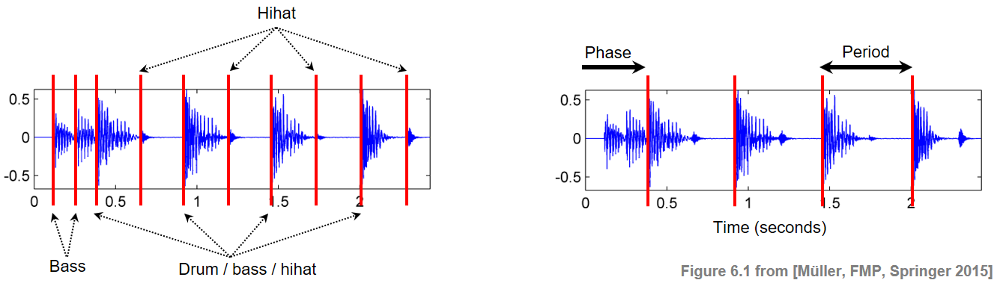

In [6]:
ipd.display(Image(path_img+"FMP_C6_F01.png", width=700))
ipd.display(Audio(path_data+"FMP_C6_F01_Queen.wav"))

- 오디오 녹음에서 템포 및 비트 정보를 추출하는 것은 특히 약한 음의 온셋이나 지역적인 템포 변경이 있는 음악의 경우 어려운 문제이다.
    - 예를 들어, 낭만주의 피아노 음악의 경우 피아니스트는 종종 **템포 루바토(rubato)** 라고도 하는 템포의 속도를 높이거나 낮추는 방식을 쓴다.
    
- 또한 템포와 비트의 개념이 모호하거나 존재하지 않는 광범위한 음악이 있다.

- 때때로 음악의 리드미컬한 흐름은 **싱코페이션 (syncopation)** 에 의해 의도적으로 중단되거나 방해되는데, 여기서 규칙적인 비트 위치 그리드 외부의 특정 음이 강조된다. 

- 다음 오디오 예는 몇 가지 문제를 나타낸다.

In [7]:
# weak onset
print('약한 온셋:')
fn_tmp1="FMP_C6_Audio_PorUnaCabeza.wav"
fn_tmp2="FMP_C6_Audio_Borodin-sec39_RWC.wav"
ipd.display(Audio(path_data+fn_tmp1))
ipd.display(Audio(path_data+fn_tmp2))

약한 온셋:


In [8]:
# romantic-music with tempo change
print('로컬 템포 변동(루바포)와 전역 템포 변화:')
fn_tmp1="FMP_C6_Audio_Chopin.wav"
ipd.display(Audio(path_data+fn_tmp1))

로컬 템포 변동(루바포)와 전역 템포 변화:


In [9]:
# syncopation

print('싱코페이션:')
fn_tmp1="FMP_C6_Audio_Faure_Op015-01-sec0-12_SMD126.wav"
ipd.display(Audio(path_data+fn_tmp1))

싱코페이션:


- 템포 및 비트 트래킹 문제를 실현 가능하게 만들기 위한 대부분의 자동화된 접근 방식은 두 가지 기본 가정에 의존한다.
     * 첫 번째 가정은 비트 위치가 음의 온셋 위치에서 발생한다는 것이고,
     * 두 번째 가정은 비트 위치가 적어도 특정 기간 동안은 다소 균등한 간격을 두고 있다는 것이다.

- 두 가지 가정은 모두 위반될 수 있고 특정 유형의 음악에 부적절할 수 있지만, 대부분의 록 및 대중가요를 포함한 광범위한 음악에 대해 편리하고 합리적인 방법이다.

- 다음 코드 셀에서는 위의 각 예에 대해 수동으로 주석이 달린 비트 위치(**4분음표 수준**)와 함께 스펙트럼 기반 노벨티 함수의 시각화를 제시한다. 또한 **소니피케이션(sonification)** 은 원본 음악 녹음 위에 배치된 짧은 클릭 사운드로 주석이 달린 비트를 나타낸다.

In [10]:
def plot_sonify_novelty_beats(fn_wav, fn_ann, title=''):
    ann, label_keys = read_annotation_pos(fn_ann, label='onset', header=0)
    df = pd.read_csv(fn_ann, sep=';', keep_default_na=False, header=None)
    beats_sec = df.values
    x, Fs = librosa.load(fn_wav)
    x_duration = len(x)/Fs
    nov, Fs_nov = compute_novelty_spectrum(x, Fs=Fs, N=2048, H=256, gamma=1, M=10, norm=1)
    figsize=(8,1.5)
    fig, ax, line = plot_signal(nov, Fs_nov, color='k', figsize=figsize,
                title=title)
    plot_annotation_line(ann, ax=ax, label_keys=label_keys, 
                        nontime_axis=True, time_min=0, time_max=x_duration)
    plt.show()
    x_beats = librosa.clicks(times=beats_sec, sr=Fs, click_freq=1000, length=len(x))
    ipd.display(Audio(x + x_beats, rate=Fs))

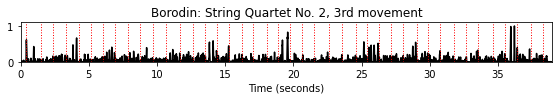

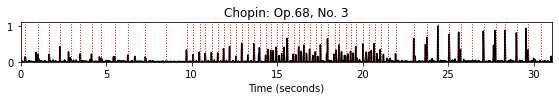

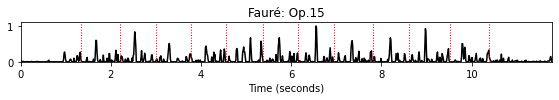

In [11]:
title = 'Borodin: String Quartet No. 2, 3rd movement' 
fn_ann = 'FMP_C6_Audio_Borodin-sec39_RWC_quarter.csv'
fn_wav = 'FMP_C6_Audio_Borodin-sec39_RWC.wav'
plot_sonify_novelty_beats(path_data+fn_wav, path_data+fn_ann, title)

title = 'Chopin: Op.68, No. 3' 
fn_ann = 'FMP_C6_Audio_Chopin.csv'
fn_wav = 'FMP_C6_Audio_Chopin.wav'
plot_sonify_novelty_beats(path_data+fn_wav, path_data+fn_ann, title)

title = 'Fauré: Op.15' 
fn_ann = 'FMP_C6_Audio_Faure_Op015-01-sec0-12_SMD126.csv'
fn_wav = 'FMP_C6_Audio_Faure_Op015-01-sec0-12_SMD126.wav'
plot_sonify_novelty_beats(path_data+fn_wav, path_data+fn_ann, title)

## 템포그램(Tempogram) 표현

- 푸리에 분석에서 크기(magnitude) 스펙트로그램(spectrogram)는 주어진 신호에 대한 시간-주파수 표현이다. 스펙트로그램의 큰 값 $\mathcal{Y}(t,\omega)$는 신호가 시간 인스턴스 $t$에 주파수 $\omega$에 해당하는 주기적(periodic) 성분을 포함하고 있음을 나타낸다.

- 이제 주어진 음악 녹음에 대한 특정 템포의 로컬 관련성을 각 시간 인스턴스에 대해 나타내는 **템포그램(tempogram)** 이라는 유사한 개념을 소개한다. 수학적으로, 템포그램을 다음과 같은 함수로 모델링한다.
$$\mathcal{T}:\mathbb{R}\times \mathbb{R}_{>0}\to \mathbb{R}_{\geq 0}$$
초 단위의 시간 매개변수 $t\in\mathbb{R}$와 분 당 비트(beats per minute = **BPM**)단위의 템포 매개변수로 측정

- 직관적으로 $\mathcal{T}(t,\tau)$ 값은 신호가 시간 인스턴스 $t$ 근처에서 주어진 템포 $\tau$의 로컬 주기 펄스(pulse)를 포함하는 정도를 나타낸다.

- 스펙트로그램과 마찬가지로 실제로는 이산 시간-템포 그리드에서만 템포그램을 계산한다. 이전과 같이 샘플링된 시간 축은 $[1:N]$로 주어진다고 가정한다. 경계(boundary) 케이스를 피하고, 이후 표기를 단순화하기 위해 이 축을 $\mathbb{Z}$로 확장한다. 또한 $\Theta\subset\mathbb{R}_{>0}$를 $\mathrm{BPM}$으로 지정된 유한한 템포 집합이라고 한다.

- 그러면 **이산 템포그램(discrete tempogram)** 은 다음의 함수이다.
$$\mathcal{T}:\mathbb{Z}\times \Theta\to \mathbb{R}_{\geq 0}.$$

- 주어진 오디오 녹음에서 템포그램 표현을 유도하는 대부분의 방식은 두 단계로 진행된다.
    * 일반적으로 펄스 위치는 음 온셋과 함께 진행된다는 가정하에 음악 신호를 먼저 노벨티 함수로 변환한다. 이 함수는 일반적으로 임펄스 같은(impulse-like) 스파이크(spike)로 구성되며 각 스파이크는 음 온셋 위치를 나타낸다.
    * 두번째 단계에서는 노벨티 함수의 로컬 주기성(locally periodic behavior)을 분석한다.

- 템포그램을 얻기 위해 주어진 시간 인스턴스 근처에서 다양한 기간 $T>0$(초 단위)에 대한 주기적인 행동을 정량화한다. 속도 $\omega=1/T$($\mathrm{Hz}$로 측정)와 템포 $\tau$($\mathrm{BPM}$로 측정)는 다음과 같이 연관된다: $\tau = 60 \cdot \omega$

- 예를 들어, $T=0.5~\mathrm{sec}$ 주기로 규칙적으로 간격을 impulse-like spike 시퀀스는 $\omega=1/T=2~\mathrm{Hz}$ 또는 $\tau=120~\mathrm{BPM}$의 템포에 해당한다.

## 펄스 수준 (Pulse Levels)

- 음악 녹음의 템포를 결정하는 주요 문제 중 하나는 음악의 펄스가 종종 리듬을 나타내는 복잡한 계층으로 구성된다는 사실이다. 특히 템포와 비트에 대한 인간의 인식에 기여하는 다양한 수준이 있다.

- "**tactus**" 수준은 일반적으로 4분 음표 수준에 해당하며 종종 발 두드리기 속도와 일치한다.

- 더 큰 음계에서 생각하면 특히 빠른 음악이나 강한 루바토가 있는 표현력이 풍부한 음악을 들을 때 "**measure**" 수준에서 템포를 인식할 수도 있다.

- 마지막으로 신호에서 발생하는 음악적으로 의미 있는 악센트의 가장 빠른 반복 속도를 나타내는 "**tatum**"(시간 원자) 수준을 고려할 수도 있다. 다음 예는 "Happy Birthday to you"라는 노래를 사용하여 이러한 개념을 설명한다.

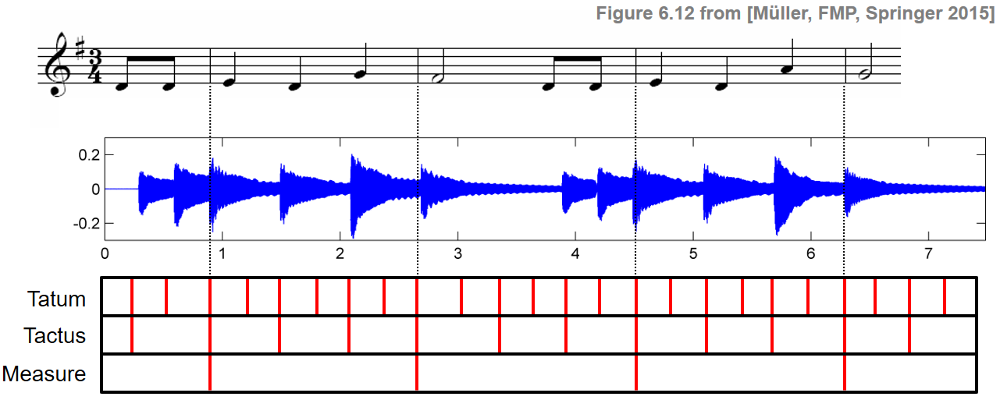

In [12]:
ipd.display(Image(path_img+"FMP_C6_F12.png", width=500))
ipd.display(Audio(path_data+"FMP_C6_Audio_HappyBirthday.wav"))

- 다음 코드 셀에서는 스펙트럼 기반 노벨티 함수 위에 표시되는 다양한 펄스 수준에 대해 수동으로 주석이 달린 펄스 위치를 시각화한다. 또한 원본 음악 녹음과 겹쳐진 펄스 위치의 **sonification**를 들을 수 있다.

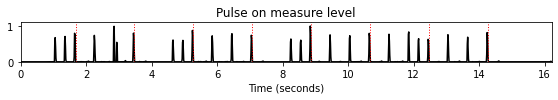

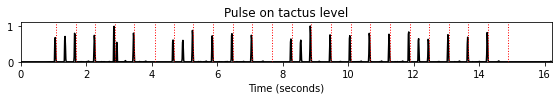

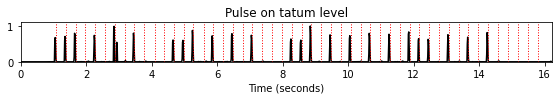

In [13]:
title = 'Pulse on measure level'
fn_ann = 'FMP_C6_Audio_HappyBirthday_measure.csv'
fn_wav = 'FMP_C6_Audio_HappyBirthday.wav'
plot_sonify_novelty_beats(path_data+fn_wav, path_data+fn_ann, title)

title = 'Pulse on tactus level'
fn_ann = 'FMP_C6_Audio_HappyBirthday_tactus.csv'
fn_wav = 'FMP_C6_Audio_HappyBirthday.wav'
plot_sonify_novelty_beats(path_data+fn_wav, path_data+fn_ann, title)

title = 'Pulse on tatum level'
fn_ann = 'FMP_C6_Audio_HappyBirthday_tatum.csv'
fn_wav = 'FMP_C6_Audio_HappyBirthday.wav'
plot_sonify_novelty_beats(path_data+fn_wav, path_data+fn_ann, title)

## 템포 옥타브, 하모닉, 서브하모닉

- 종종 서로 다른 펄스 수준의 존재로 인해 발생하는 템포 모호성은 템포그램 $\mathcal{T}$에도 반영된다. 더 높은 펄스 레벨은 종종 주어진 템포 $\tau$의 정수 배수 $\tau,2\tau,3\tau,\ldots$에 해당한다.
- 피치와 마찬가지로 이러한 정수 배수를 $\tau$의 **(템포) 하모닉(=배음,고조파)(harmonics)** 이라고 한다.
- 또한, 정수 분수 $\tau,\tau/2,\tau/3,\ldots$는 $\tau$의 **(템포) 서브하모닉(subharmonics)** 이라고 한다.
- 음악 피치의 옥타브 개념과 유사하게, 값이 절반 또는 두 배인 두 템포 사이의 차이를 **템포 옥타브(octave)** 라고 한다.

- 다음 예는 증가하는 템포($20~\mathrm{sec}$ 과정에서 $170$에서 $200~\mathrm{BPM}$로 상승)의 클릭 트랙에 대한 두 가지 유형의 템포그램을 보여준다.
    - 첫 번째 템포그램은 템포 하모닉을 강조하고 두 번째 템포그램은 템포 서브하모닉을 강조한다.
    - 빨간색 사각형으로 표시된 항목은 음악 신호가 $t=5~\mathrm{sec}$ 시간 위치를 중심으로 $\tau=180~\mathrm{BPM}$의 우세한(dominant) 템포를 가지고 있음을 나타낸다.

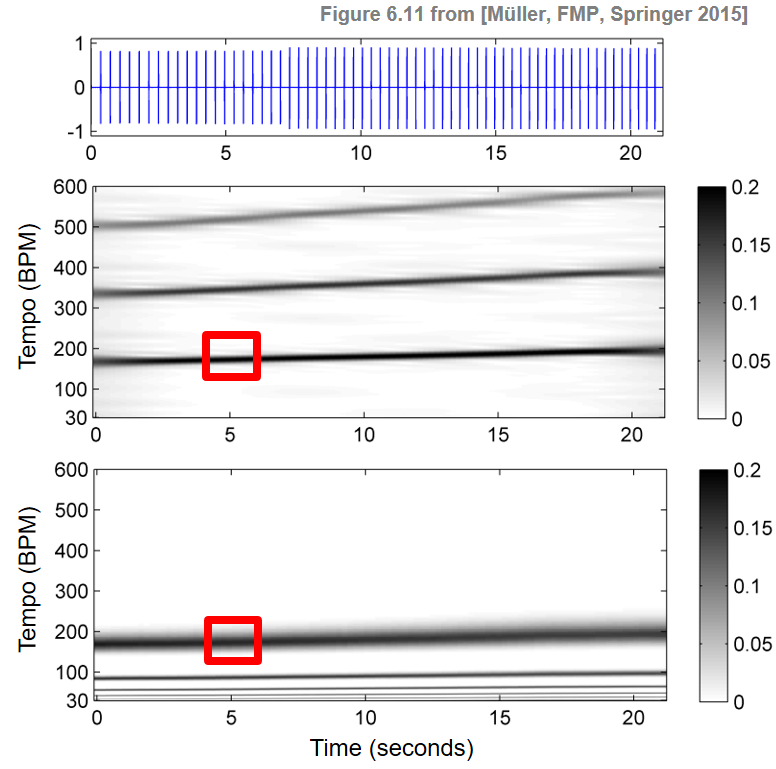

In [14]:
ipd.display(Image(path_img+"FMP_C6_F11.png", width=500))
ipd.display(Audio(path_data+"FMP_C6_F11_ClickTrack-BPM170-200.wav"))

## 전역적 템포 (Global Tempo)

- 어느 정도 일정한 템포를 가정하면 전체 녹음에 대해 하나의 **전역적(global)** 템포 값을 결정하는 것으로 충분하다. 이러한 값은 프레임별 주기성 분석을 통해 얻은 템포 값을 평균하여 얻을 수 있다. 예를 들어, 템포그램 표현을 기반으로 모든 시간 프레임에 대한 템포 값을 평균화하여 $\tau\in\Theta$에만 의존하는$\mathcal{T}_\mathrm{Average}:\Theta\to\mathbb{R}_{\geq0}$ 함수를 얻을 수 있다. 

- 관련된 시간 위치가 $[1:N]$ 간격에 있다고 가정하면 다음과 같이 $\mathcal{T}_\mathrm{Average}$를 정의할 수 있다.
$$\mathcal{T}_\mathrm{Average}(\tau) := \frac{1}{N}\sum_{n\in[1:N]} \mathcal{T}(n,\tau)$$

- 이 함수의 최대값 $$\hat{\tau} := \max\{\mathcal{T}_\mathrm{Average}(\tau)\,\mid\, \tau\in\Theta\}$$ 는 녹음의 전체 템포에 대한 추정치를 산출한다.

- 물론 단일 템포 값을 추정하는 보다 정교한 방법이 적용될 수 있다. 예를 들어 단순 평균을 사용하는 대신 이상값과 노이즈에 더 강력한 중앙값 필터링을 적용할 수 있다.

# 푸리에 템포그램 (Fourier Tempogram)

##  정의

- 피크가 음 온셋 후보를 나타내는 이산 시간 노벨티 함수 $\Delta:\mathbb{Z}\to\mathbb{R}$가 주어진다고 가정하자.

- 푸리에 분석의 아이디어는 윈도우(windowed) 정현파와 비교하여 노벨티 곡선의 로컬 주기성을 감지하는 것이다. $\Delta$의 로컬 섹션과 윈도우 정현파의 높은 상관관계는 정현파 주파수의 주기성을 나타낸다(적절한 위상이 주어짐).

- 이 (위상과 함께) 상관 관계는 단시간 푸리에 변환을 사용하여 계산할 수 있다. 이를 위해 $n=0$을 중심으로 하는 유한 길이의 윈도우 함수 $w:\mathbb{Z}\to\mathbb{R}$를 수정한다(예: 샘플링된 Hann 윈도우). 그러면 주파수 매개변수 $\omega\in\mathbb{R}_{\geq 0}$ 및 시간 매개변수 $n\in\mathbb{Z}$에 대해 복소 푸리에 계수 $\mathcal{F}(n ,\omega)$는 다음과 같이 정의된다.
$$\mathcal{F}(n,\omega) := \sum_{m\in\mathbb{Z}}
\Delta(m)\overline{w}(m-n)\mathrm{exp}(-2\pi i\omega m).$$

- 이 정의는 홉 크기 $H=1$를 사용할 때 이산 단시간 푸리에 변환과 유사하다.

- 주파수를 템포 값으로 변환하면 (이산) **푸리에 템포그램** $\mathcal{T}^\mathrm{F}: \mathbb{Z} \times \Theta \to \mathbb{R}_{\geq 0}$를 다음과 같이 정의한다.
$$\mathcal{T}^\mathrm{F}(n,\tau) := |\mathcal{F}(n,\tau/60)|$$

- 실제 적용을 위해 $\mathcal{T}^\mathrm{F}$는 소수의 템포 매개변수에 대해서만 계산된다.
    - 예를 들어, $30$와 $600~\mathrm{BPM}$ 사이의 (정수) 음악 템포를 포함하는 $\Theta=[30:600]$ 세트를 선택할 수 있다.
    - 이 경계는 약 $100~\mathrm{msec}$ ($600~\mathrm{BPM}$)와 $2~\mathrm{sec}$ ($30~\mathrm{BPM}$)사이의 시간적 분리를 보여주는 음악 이벤트만 템포 인식에 기여한다는 가정하에 주어진 것이다.
    
- 각각의 응용과 음악 녹음의 특성에 따라 오디오의 $4$ ~ $12~\mathrm{sec}$에 해당하는 창 크기를 고르는 것이 합리적인 범위이다. 또한 홉 크기 매개변수 $H$를 도입하여 결과로 나타나는 템포그램의 피쳐 레이트를 조정할 수 있다.

## 템포 해상도 (Tempo Resolution)

- $\Theta=[30:600]$와 같은 템포 집합을 사용하려면 고해상도의 스펙트럼 분석이 필요하다. (특히 낮은 주파수 범위에서)

- 예를 들어, 입력 노벨티 함수 $\Delta$가 특징 샘플링 레이트 $F_\mathrm{s}^\Delta = 100~\mathrm{Hz}$이고 윈도우 $w$의 길이가 $N=1000$ (노벨티 함수 $\Delta$의 $10$초를 커버)라고 가정하자.

- 그런 다음 $N$ 크기의 DFT를 적용하면 다음의 물리적 주파수에 해당하는 푸리에 계수가 생성된다.
$$\omega = F_\mathrm{coef}(k) := \frac{k\cdot F_\mathrm{s}^\Delta}{N} = k\cdot 0.1 ~\mathrm{Hz}$$
for $k\in[0:500]$
    - 템포 $\tau= k\cdot 6~\mathrm{BPM}$에 해당

- 즉, DFT는 $\tau=0$에서 $\tau=3000~\mathrm{BPM}$ 범위의 템포 추정치로 $6~\mathrm{BPM}$의 템포 해상도를 생성한다. $\Theta=[30:600]$와 같은 특정 템포 집합에 관심이 있는 경우, 푸리에 계수($k\in[5:100]$)의 작은 부분만 필요하다. 또한 $6~\mathrm{BPM}$의 템포 해상도는 충분하지 않다. 따라서 DFT를 기반으로 하는 간단한 STFT는 적합하지 않을 수 있다. 한 가지 대안은 필요한 푸리에 계수를 개별적으로 계산하는 것이다(DFT를 사용하지 않음). 이는 FFT 알고리즘을 통해 수행할 수 없지만 상대적으로 적은 수의 푸리에 계수(템포 집합 $\Theta$에 해당)만 계산하면 되므로 계산 복잡성은 여전히 합리적일 수 있다.

## 구현

- 다음의 식과 비슷한 구현을 보자.
$$\mathcal{F}(n,\omega) = \sum_{m\in\mathbb{Z}} \Delta(m)\overline{w}(m-n)\mathrm{exp}(-2\pi i \omega m).$$

- 노벨티 함수 $\Delta$이 길이 $L\in\mathbb{N}$를 가진다고 가정하자. 윈도우 함수 $w$는 $N\in\mathbb{N}$ 길이의 Hann 윈도우로 하며, 홉 크기 $H\in\mathbb{N}$만큼 이동한다. 또한 "centered view"를 사용하여 노벨티 함수을 윈도우 길이의 반만큼 제로-패딩시킨다.

- 결과적으로 $n=0$에 의해 인덱싱된 $\mathcal{F}$의 첫 번째 프레임은 물리적 시간 위치 $t=0~\mathrm{sec}$에 해당한다. 홉 크기 매개변수 $H$는 템포그램의 프레임 속도를 $F_\mathrm{s}^\Delta/H$로 줄인다. 인풋으로 템포 값을 포함하는 유한 집합 $\Theta$를 지정할 수 있다. 

- 밑의 알고리즘에는 $\tau\in\Theta$를 반복하는 외부 루프가 있다. 각 주파수 $\omega=\tau/60$에 대해 $\mathcal{F}(n,\omega)$ 값은 프레임 인덱스 $n$에서 반복되는 내부 루프에서 계산된다. 10초 듀레이션의 합성 노벨티 함수를 사용하며, 곡선은 전반부의 템포가 $150~\mathrm{BPM}$이고 후반부의 템포가 $120~\mathrm{BPM}$인 클릭 트랙으로 구성된다.

In [15]:
def compute_tempogram_fourier(x, Fs, N, H, Theta=np.arange(30, 601, 1)):
    """Compute Fourier-based tempogram [FMP, Section 6.2.2]

    Args:
        x (np.ndarray): Input signal
        Fs (scalar): Sampling rate
        N (int): Window length
        H (int): Hop size
        Theta (np.ndarray): Set of tempi (given in BPM) (Default value = np.arange(30, 601, 1))

    Returns:
        X (np.ndarray): Tempogram
        T_coef (np.ndarray): Time axis (seconds)
        F_coef_BPM (np.ndarray): Tempo axis (BPM)
    """
    win = np.hanning(N)
    N_left = N // 2
    L = x.shape[0]
    L_left = N_left
    L_right = N_left
    L_pad = L + L_left + L_right
    # x_pad = np.pad(x, (L_left, L_right), 'constant')  # doesn't work with jit
    x_pad = np.concatenate((np.zeros(L_left), x, np.zeros(L_right)))
    t_pad = np.arange(L_pad)
    M = int(np.floor(L_pad - N) / H) + 1
    K = len(Theta)
    X = np.zeros((K, M), dtype=np.complex_)

    for k in range(K):
        omega = (Theta[k] / 60) / Fs
        exponential = np.exp(-2 * np.pi * 1j * omega * t_pad)
        x_exp = x_pad * exponential
        for n in range(M):
            t_0 = n * H
            t_1 = t_0 + N
            X[k, n] = np.sum(win * x_exp[t_0:t_1])
        T_coef = np.arange(M) * H / Fs
        F_coef_BPM = Theta
    return X, T_coef, F_coef_BPM

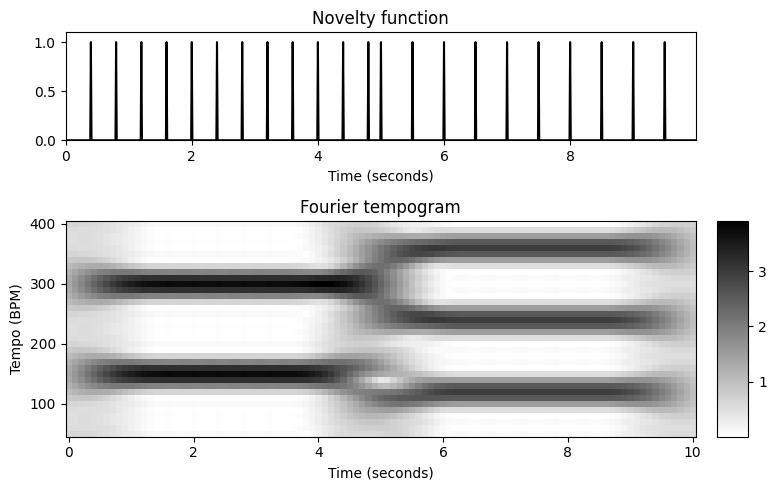

In [16]:
Fs = 100
L = 10*Fs
x = np.zeros(L)
peaks = np.concatenate((np.arange(40,L//2,40),np.arange(500,L,50)))
x[peaks]=1

N = 300 #corresponding to 3 seconds (Fs = 100)
H = 10
Theta = np.arange(50,410,10)

X, T_coef, F_coef_BPM = compute_tempogram_fourier(x, Fs, N=N, H=H, Theta=Theta)
tempogram = np.abs(X)
#tempogram = libfmp.c3.normalize_feature_sequence(tempogram, norm='max')

fig, ax = plt.subplots(2, 2, gridspec_kw={'width_ratios': [1, 0.05], 
                                          'height_ratios': [1, 2]}, figsize=(8, 5))        
plot_signal(x, Fs, ax=ax[0,0], color='k', title='Novelty function')
ax[0,1].set_axis_off()
plot_matrix(tempogram, T_coef=T_coef, F_coef=F_coef_BPM, ax=[ax[1,0], ax[1,1]], 
                     title='Fourier tempogram', ylabel='Tempo (BPM)', colorbar=True);
plt.tight_layout()

- 푸리에 템포그램 $\mathcal{T}^\mathrm{F}$의 시각화는 시간이 지남에 따라 우세한 템포를 나타낸다. 실제로 처음 5초 동안 $\tau=150~\mathrm{BPM}$에 대한 높은 값과 마지막 5초 동안 $\tau=120~\mathrm{BPM}$ 템포에 대한 높은 값이 있다.
- 푸리에 분석을 기반으로 하므로 항목 $\mathcal{T}^\mathrm{F}(n,\tau)$는 템포 $\tau$(또는 주파수 $\omega=\tau/60$)를 나타내는 윈도우(windowed) 정현파로 된 $n$ 근처의 노벨티 함수 $\Delta$를 비교하여 얻어진다.

- 다음 코드 셀에서 이러한 분석은 템포그램 시각화에서 빨간색 점으로 표시된 다양한 시간-템포 쌍으로 설명된다.

In [17]:
def compute_sinusoid_optimal(c, tempo, n, Fs, N, H):
    """Compute windowed sinusoid with optimal phase

    Args:
        c (complex): Coefficient of tempogram (c=X(k,n))
        tempo (float): Tempo parameter corresponding to c (tempo=F_coef_BPM[k])
        n (int): Frame parameter of c
        Fs (scalar): Sampling rate
        N (int): Window length
        H (int): Hop size

    Returns:
        kernel (np.ndarray): Windowed sinusoid
        t_kernel (np.ndarray): Time axis (samples) of kernel
        t_kernel_sec (np.ndarray): Time axis (seconds) of kernel
    """
    win = np.hanning(N)
    N_left = N // 2
    omega = (tempo / 60) / Fs
    t_0 = n * H
    t_1 = t_0 + N
    phase = - np.angle(c) / (2 * np.pi)
    t_kernel = np.arange(t_0, t_1)
    kernel = win * np.cos(2 * np.pi * (t_kernel*omega - phase))
    t_kernel_sec = (t_kernel - N_left) / Fs
    return kernel, t_kernel, t_kernel_sec


def plot_signal_kernel(x, t_x, kernel, t_kernel, xlim=None, figsize=(8, 2), title=None):
    """Visualize signal and local kernel

    Args:
        x: Signal
        t_x: Time axis of x (given in seconds)
        kernel: Local kernel
        t_kernel: Time axis of kernel (given in seconds)
        xlim: Limits for x-axis (Default value = None)
        figsize: Figure size (Default value = (8, 2))
        title: Title of figure (Default value = None)

    Returns:
        fig: Matplotlib figure handle
    """
    if xlim is None:
        xlim = [t_x[0], t_x[-1]]
    fig = plt.figure(figsize=figsize)
    plt.plot(t_x, x, 'k')
    plt.plot(t_kernel, kernel, 'r')
    plt.title(title)
    plt.xlim(xlim)
    plt.tight_layout()
    return fig

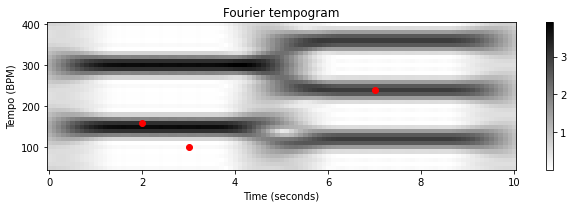

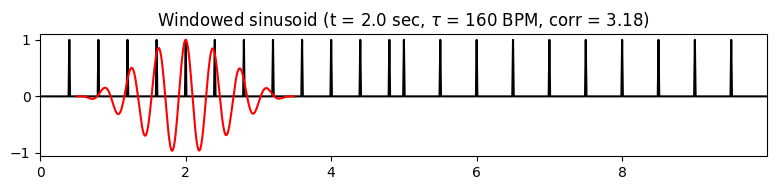

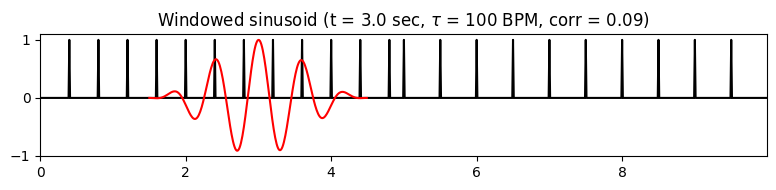

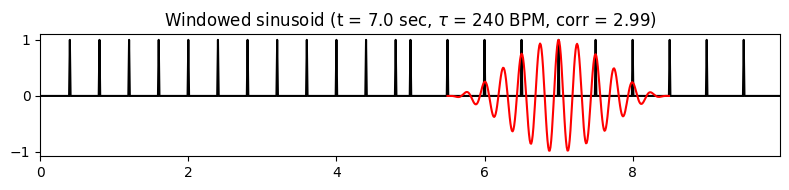

In [18]:
t_x = np.arange(x.shape[0])/Fs
coef_n = [20, 30, 70]
coef_k = [11, 5, 19]

fig, ax, im = plot_matrix(tempogram, 
                T_coef=T_coef, F_coef=F_coef_BPM, figsize=(9,3),
                title='Fourier tempogram', ylabel='Tempo (BPM)', colorbar=True);
ax[0].plot(T_coef[coef_n],F_coef_BPM[coef_k],'ro')

for i in range(len(coef_k)):
    k = coef_k[i]
    n = coef_n[i]
    tempo = F_coef_BPM[k]
    time = T_coef[n]
    corr = np.abs(X[k,n])
    kernel, t_kernel, t_kernel_sec = compute_sinusoid_optimal(X[k,n], 
                        F_coef_BPM[k], n, Fs, N, H)
    title=r'Windowed sinusoid (t = %0.1f sec, $\tau$ = %0.0f BPM, corr = %0.2f)'%(time, tempo, corr)
    fig = plot_signal_kernel(x, t_x, kernel, t_kernel_sec, title=title)
plt.tight_layout()

- 첫 번째 시간-템포 쌍($t=2~\mathrm{sec}$, $\tau=160~\mathrm{BPM}$)의 경우, 윈도우 정현파의 양의 부분이 노벨티 함수 $\Delta$의 impulse-like 피크와 잘 정렬된다. 반면 정현파의 음수 부분은 $\Delta$의 0 영역에 속한다. 결과적으로 윈도우 정현파와 $\Delta$ 사이에는 높은 상관관계가 있으며, 이는 큰 계수 $\mathcal{T}^\mathrm{F}(n,\tau)$로 이어진다.


- 두 번째 쌍($t=3$, $\tau=100$)의 경우 정현파는 작은 계수로 이어진다. 이 경우 $\Delta$의 일부 피크는 정현파의 양수 부분에 속하고 다른 피크는 정현파의 음수 부분에 속한다. 취소의 결과로 인해 $\Delta$와 정현파 사이의 전체 상관 관계는 작다.


- 마지막으로 세 번째 쌍($t=7$, $\tau=240$)은 주 템포의 두 배를 나타내는 정현파를 사용할 때 높은 상관관계를 얻는 것을 보여준다. 이 경우 $\Delta$의 피크는 정현파의 모든 두 번째 양의 부분과 정렬되는 반면 정현파의 다른 모든 부분은 $\Delta$의 0 영역에 속한다. 이 논의는 푸리에 템포그램이 일반적으로 **템포 하모닉**을 나타내지만 **템포 서브하모닉**을 억제한다는 것을 보여준다.

## 예시

- $F_\mathrm{s}^\Delta = 100~\mathrm{Hz}$로 리샘플링된 스펙트럼 기반 노벨티 함수로 시작한다. 또한 $5$초($N=500$)에 해당하는 윈도우 크기와 해상도 $1~\mathrm{BPM}$의 템포 집합 $\Theta=[30:600]$를 사용한다. 홉 크기 매개변수 $H=10$를 사용하면 결과 템포그램의 피쳐 레이트는 $10~\mathrm{Hz}$가 된다.

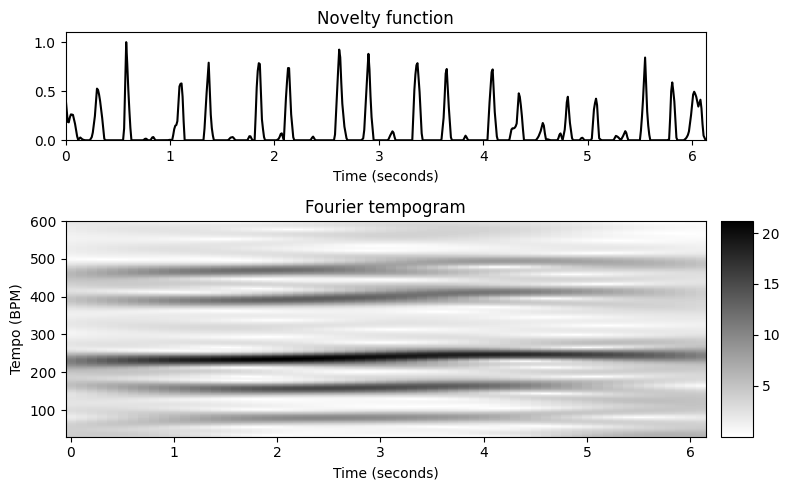

In [19]:
fn_wav = 'FMP_C6_F07_Shostakovich_Waltz-02-Section_IncreasingTempo.wav'
Fs = 22050
x, Fs = librosa.load(path_data+fn_wav, sr=Fs) 

nov, Fs_nov = compute_novelty_spectrum(x, Fs=Fs, N=2048, H=512, gamma=100, M=10, norm=True)
nov, Fs_nov = resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)

N = 500 #corresponding to 5 seconds (Fs_nov = 100)
H = 10
Theta = np.arange(30, 601)
X, T_coef, F_coef_BPM = compute_tempogram_fourier(nov, Fs_nov, N=N, H=H, Theta=Theta)
tempogram = np.abs(X)

fig, ax = plt.subplots(2, 2, gridspec_kw={'width_ratios': [1, 0.05], 
                                          'height_ratios': [1, 2]}, figsize=(8,5))        
plot_signal(nov, Fs_nov, ax=ax[0,0], color='k', title='Novelty function')
ax[0,1].set_axis_off()
plot_matrix(tempogram, T_coef=T_coef, F_coef=F_coef_BPM, ax=[ax[1,0], ax[1,1]], 
                     title='Fourier tempogram', ylabel='Tempo (BPM)', colorbar=True);
plt.tight_layout()

- 푸리에 템포그램 $\mathcal{T}^\mathrm{F}$에서 알 수 있듯이 이 발췌의 지배적 템포는 $200$와 $300~\mathrm{BPM}$ 사이이다. 대략 $\tau=225~\mathrm{BPM}$부터 시작하여 시간이 지남에 따라 템포가 약간 증가한다. 흥미롭게도 3/4박자 내에서 세 번째 박자마다 약한 강박으로 인해 템포그램 $\mathcal{T}^\mathrm{F}$도 메인 템포의 $1/3$ 및 $2/3$에 해당하는 더 큰 계수를 보여준다. 

# 자기상관 템포그램 (Autocorrelation Tempogram)

##  자기상관 (Autocorrelation)

- 두 번째 주기성 추정 방법으로 푸리에 기반 접근 외에 자기상관 기반 접근에 대해 논의한다. 일반적으로 **자기상관**은 신호와 신호의 시간 이동 버전의 유사성을 측정하기 위한 수학적 도구이다.
- $x:\mathbb{Z}\to\mathbb{R}$가 에너지가 유한한 이산시간 신호라고 하자. 실수 값 신호 $x$의 자기상관 $R_{xx}:\mathbb{Z}\to\mathbb{R}$는 다음과 같이 정의된다.
$$R_{xx}(\ell) = \sum_{m\in\mathbb{Z}} x(m)x(m-\ell)$$
이는 time-shift 또는 **lag** 매개변수 $\ell\in\mathbb{Z}$에 의존하는 함수를 생성한다.

- 자기 상관 $R_{xx}(\ell)$은 $\ell=0$에서 최대이고 $\ell$에서 대칭이다. 직관적으로, 주어진 lag에 대한 자기상관이 큰 경우, 신호에는 lag 매개변수로 구체화되는, 시간 간격으로 구분되는 반복적 패턴이 포함된다.
- 다음 예에서는 period 9와 period 14의 두 가지 클릭 트랙 패턴으로 구성된 신호를 고려한다.

- 자기상관은 lag $\ell=0$(신호가 자체와 유사함)에서 사소하게 피크를 가지며, $\ell=9$(첫 번째 period), $\ell=14$(두 번째 period), $\ ell=18$(첫 번째 period의 두 배), $\ell=27$(첫 번째 period의 세 배, $\ell=28$에서 두 번째 period의 두 배) 등이다. 특히 자기상관이 lag $\ell$에서 피크를 갖는다면 $\ell$의 정수배에서도 피크를 갖는다.

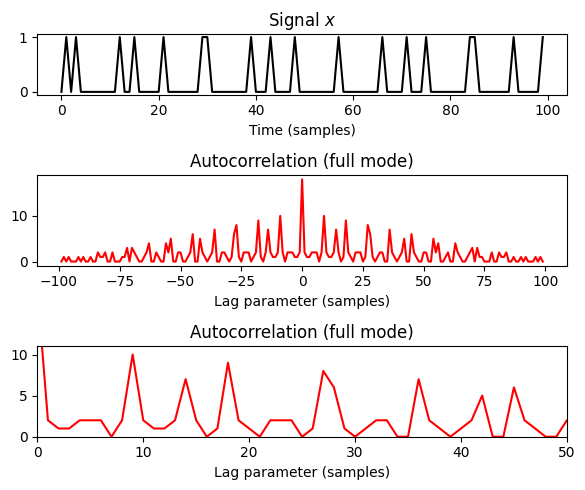

In [20]:
N = 100
x = np.zeros(N)
x[np.arange(1,N,14)] = 1
x[np.arange(3,N,9)] = 1

fig, ax = plt.subplots(3, 1, gridspec_kw={'height_ratios': [1, 1.5, 1.5]}, figsize=(6, 5))       

ax[0].plot(x, 'k')
ax[0].set_title('Signal $x$')
ax[0].set_xlabel('Time (samples)')

r_xx = np.correlate(x, x, mode='full')
lag_axis = np.arange(-(N-1),N)
ax[1].plot(lag_axis,r_xx, 'r')
ax[1].set_title('Autocorrelation (full mode)')
ax[1].set_xlabel(r'Lag parameter (samples)')

r_xx = np.correlate(x, x, mode='full')
lag_axis = np.arange(-(N-1),N)
ax[2].plot(lag_axis,r_xx, 'r')
ax[2].set_title('Autocorrelation (full mode)')
ax[2].set_xlabel(r'Lag parameter (samples)')
ax[2].set_xlim([0,50])
ax[2].set_ylim([0,11])

plt.tight_layout()

## 단기 자기상관 (Short-Time Autocorrelation)

- 주어진 시간 매개변수 $n$ 근처에서 주어진 노벨티 함수 $\Delta:\mathbb{Z}\to\mathbb{R}$를 분석하기 위해 로컬 방식으로 자기상관을 적용한다. 이를 위해 윈도우 함수 $w:\mathbb{Z}\to\mathbb{R}$를 고정한다.

- $n\in\mathbb{Z}$ 지점에 localized된 windowed 버전 $\Delta_{w,n}:\mathbb{Z}\to\mathbb{R}$는 다음과 같이 정의된다.
$$\Delta_{w,n}(m):=\Delta(m)w(m-n)$$
for $m\in\mathbb{Z}$

- **단시간(short-time) 자기상관** $\mathcal{A}:\mathbb{Z}\times\mathbb{Z}\to\mathbb{R}$를 얻기 위해, $\Delta_{w,n}$의 자기상관을 계산한다.
$$\mathcal{A}(n,\ell) := \sum_{m\in\mathbb{Z}}\Delta(m)w(m-n)\Delta(m-\ell) w(m-n-\ell).$$

- 다음에서는 윈도우 함수 $w:[0:N-1]\to\mathbb{R}$가 유한한 길이 $N\in\mathbb{N}$를 가진다고 가정한다. (일반적으로 수학적 편의를 위해 $[0:N-1]$ 구간 밖에서 $w$를 0으로 확장할 수 있다.)

- 그러면 유한한 수의 시차(time lag) 매개변수를 제외하고는 localized 노벨티 함수의 자기상관이 모두 0이 된다. 보다 정확하게는 $\mathcal{A}(n,\ell)=0$ for $|\ell|> N$임을 보여줄 수 있다.

- 이 속성과 자기 상관의 대칭성 때문에 시차 매개변수 $\ell\in[0:N-1]$만 고려하면 된다. 게다가, 윈도윙(windowing) 때문에 최대 $N-\ell$의 summands는 nonzero이다.

- 윈도우 효과의 균형을 맞추기 위해 $\mathcal{A}(n,\ell)$ 값을 윈도우 속성 및 윈도우의 $N-\ell$ 오버랩에 따라 달라지는 요인과 그것의 시간 이동 버전으로 나눌 수 있다.

- 단시간 자기상관 $\mathcal{A}$를 시각화하면 프레임 매개변수 $n\in\mathbb{Z}$ 및 시차 매개변수 $\ell\in[0:N-1]$로 **시간-시차(time-lag) 표현**이 된다.

## 구현

- 자기상관(autocorrelation) 템포그램를 계산하기 위한 구현을 살펴보자.

- 노벨티 곡선 $\Delta$의 길이는 $L\in\mathbb{N}$이고 샘플링 레이트는 $F_\mathrm{s}^\Delta$라고 가정한다. 윈도우 함수 $w$로 길이가 $N\in\mathbb{N}$인 직사각형 윈도우을 선택한다. 또한 hopsize 매개변수 $H\in\mathbb{N}$를 도입한다. 노벨티 함수가 윈도우 길이의 절반만큼 0으로 채워지는 **centered view**를 사용한다.

- 결과적으로 $n=0$에 의해 인덱스된 $\mathcal{A}$의 첫 번째 프레임은 물리적 시간 위치 $t=0~\mathrm{sec}$에 해당한다. 또한 홉크기 매개변수 $H$는 템포그램의 프레임 속도를 $F_\mathrm{s}^\Delta/H$로 줄인다.

- 이 알고리즘은 프레임 인덱스 $n$를 반복하고 단일 자기상관을 사용하여 모든 $\ell\in[0:N-1]$에 대해 $\mathcal{A}(n,\ell)$를 계산한다. 예시로 쇼스타코비치의 왈츠 2번 녹음에서 발췌한 부분을 본다. 또한 $F_\mathrm{s}^\Delta = 100~\mathrm{Hz}$ 및 $N=300$ 매개변수를 사용한다.

In [21]:
def compute_autocorrelation_local(x, Fs, N, H, norm_sum=True):
    """Compute local autocorrelation [FMP, Section 6.2.3]

    Args:
        x (np.ndarray): Input signal
        Fs (scalar): Sampling rate
        N (int): Window length
        H (int): Hop size
        norm_sum (bool): Normalizes by the number of summands in local autocorrelation (Default value = True)

    Returns:
        A (np.ndarray): Time-lag representation
        T_coef (np.ndarray): Time axis (seconds)
        F_coef_lag (np.ndarray): Lag axis
    """
    # L = len(x)
    L_left = round(N / 2)
    L_right = L_left
    x_pad = np.concatenate((np.zeros(L_left), x, np.zeros(L_right)))
    L_pad = len(x_pad)
    M = int(np.floor(L_pad - N) / H) + 1
    A = np.zeros((N, M))
    win = np.ones(N)
    if norm_sum is True:
        lag_summand_num = np.arange(N, 0, -1)
    for n in range(M):
        t_0 = n * H
        t_1 = t_0 + N
        x_local = win * x_pad[t_0:t_1]
        r_xx = np.correlate(x_local, x_local, mode='full')
        r_xx = r_xx[N-1:]
        if norm_sum is True:
            r_xx = r_xx / lag_summand_num
        A[:, n] = r_xx
    Fs_A = Fs / H
    T_coef = np.arange(A.shape[1]) / Fs_A
    F_coef_lag = np.arange(N) / Fs
    return A, T_coef, F_coef_lag

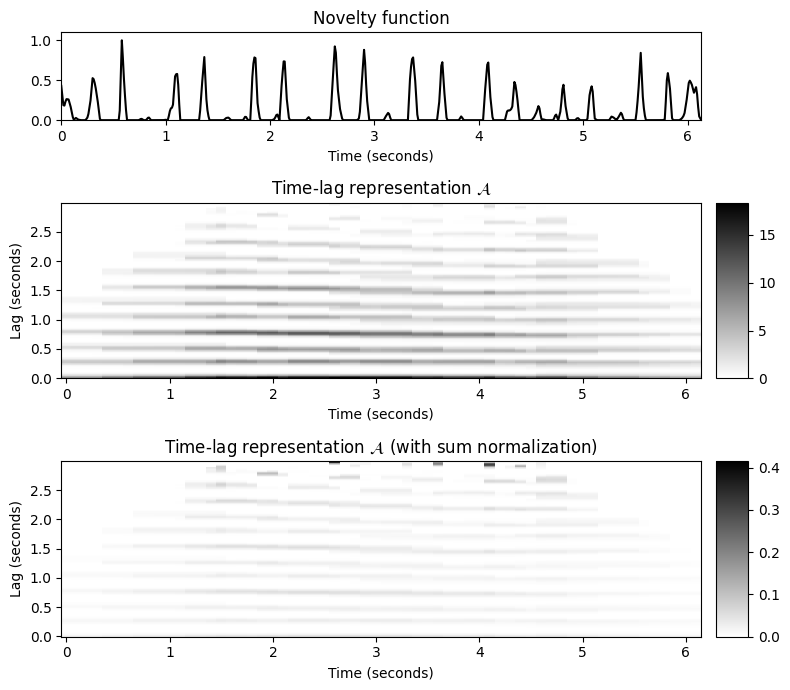

In [22]:
fn_wav = 'FMP_C6_F07_Shostakovich_Waltz-02-Section_IncreasingTempo.wav'

x, Fs = librosa.load(path_data+fn_wav) 

nov, Fs_nov = compute_novelty_spectrum(x, Fs=Fs, N=2048, H=512, gamma=100, M=10, norm=1)
nov, Fs_nov = resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)

#Autocorrelation parameters
N = 300 #corresponding to 3 seconds (Fs_nov = 100 Hz)
H = 10

A, T_coef, F_coef_lag = compute_autocorrelation_local(nov, Fs_nov, N, H, norm_sum=False)
A_norm, T_coef, F_coef_lag = compute_autocorrelation_local(nov, Fs_nov, N, H)

fig, ax = plt.subplots(3, 2, gridspec_kw={'width_ratios': [1, 0.05], 
                                          'height_ratios': [1, 2, 2]}, figsize=(8,7))        

plot_signal(nov, Fs_nov, ax=ax[0,0], color='k', title='Novelty function')
ax[0,1].set_axis_off()

plot_matrix(A, ax=[ax[1,0], ax[1,1]], T_coef=T_coef, F_coef=F_coef_lag,
                     title=r'Time-lag representation $\mathcal{A}$', ylabel='Lag (seconds)', colorbar=True);

plot_matrix(A_norm, ax=[ax[2,0], ax[2,1]], T_coef=T_coef, F_coef=F_coef_lag,
                     title=r'Time-lag representation $\mathcal{A}$ (with sum normalization)', 
                     ylabel='Lag (seconds)', colorbar=True);
plt.tight_layout()

## 해석

- 이 예에서 사용된 윈도우 $w$는 원본 오디오 녹음의 $3~\mathrm{sec}$에 해당하는 길이를 갖는 직사각형 윈도우이다.

- 먼저 시간 인스턴스 $t=2~\mathrm{sec}$에 해당하는 시간 인덱스 $n$을 보자. 
    - $\mathcal{A}(n,\ell)$를 계산하려면 $0.5~\mathrm{sec}$와 $3.5~\mathrm{sec}$ 사이의 novelty function $\Delta$의 섹션만 고려한다. 
    - Shostakovich 녹음의 템포는 이 섹션에서 대략 $230~\mathrm{BPM}$이다. 즉, 두 개의 후속 비트 사이의 간격의 지속시간은 대략 $s=0.26~\mathrm{sec}$이다.
    
- 다음으로 $s=0.26~\mathrm{sec}$의 시간 이동에 해당하는 시차 매개변수 $\ell$을 살펴보자.
    - 이 섹션의 노벨티 함수는 자신의 시간 이동된 버전과 잘 연관된다. 섹션의 피크는 한 비트 기간만큼 이동된 섹션의 피크에 떨어진다. 섹션을 2, 3 또는 그 이상의 비트 주기로 이동할 때도 마찬가지이다. 예를 들어 $s=0.78~\mathrm{sec}$(3박자 기간)의 경우이다. 이 주기는 measure level의 템포인 $77~\mathrm{BPM}$의 템포에 해당한다.
    - 반대로 비트 주기 $s=0.13~\mathrm{sec}$의 절반에 해당하는 lag $\ell$을 사용하면(double tempo $461~\mathrm{BPM}$), 섹션의 피크와 이동된 부분의 피크는 서로를 맞지 않으므로 계수 $\mathcal{A}(n,\ell)$는 0에 가깝다.

In [23]:
def plot_signal_local_lag(x, t_x, local_lag, t_local_lag, lag, xlim=None, figsize=(8, 1.5), title=''):
    """Visualize signal and local lag [FMP, Figure 6.14]

    Args:
        x: Signal
        t_x: Time axis of x (given in seconds)
        local_lag: Local lag
        t_local_lag: Time axis of kernel (given in seconds)
        lag: Lag (given in seconds)
        xlim: Limits for x-axis (Default value = None)
        figsize: Figure size (Default value = (8, 1.5))
        title: Title of figure (Default value = '')

    Returns:
        fig: Matplotlib figure handle
    """
    if xlim is None:
        xlim = [t_x[0], t_x[-1]]
    fig = plt.figure(figsize=figsize)
    plt.plot(t_x, x, 'k:', linewidth=0.5)
    plt.plot(t_local_lag, local_lag, 'k', linewidth=3.0)
    plt.plot(t_local_lag+lag, local_lag, 'r', linewidth=2)
    plt.title(title)
    plt.ylim([0, 1.1 * np.max(x)])
    plt.xlim(xlim)
    plt.tight_layout()
    return fig

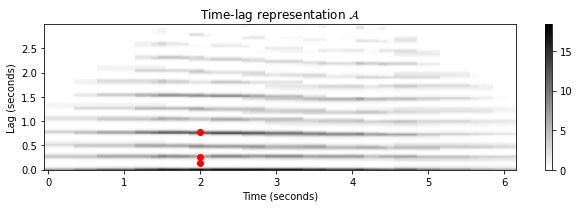

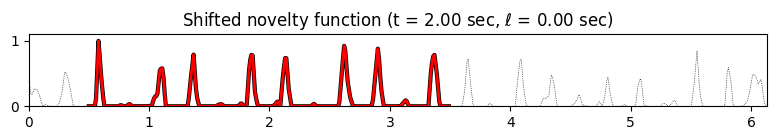

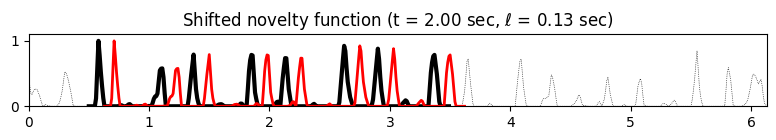

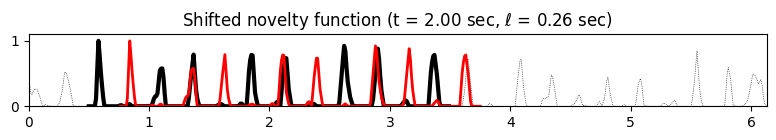

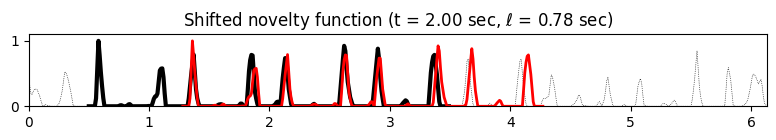

In [24]:
time_sec = np.array([2, 2, 2])
lag_sec = np.array([0.13, 0.26, 0.78])
coef_n = (time_sec * Fs_nov/H).astype(int)
coef_k = (lag_sec * Fs_nov).astype(int)

fig, ax, im = plot_matrix(A, T_coef=T_coef, F_coef=F_coef_lag, figsize=(9,3),
                     title=r'Time-lag representation $\mathcal{A}$', ylabel='Lag (seconds)', colorbar=True);
ax[0].plot(T_coef[coef_n], F_coef_lag[coef_k],'ro')

L = len(nov)
L_left = round(N/2)
L_right = L_left
nov_pad = np.concatenate( ( np.zeros(L_left), nov, np.zeros(L_right) ) )
L_pad = len(nov_pad)
win = np.ones(N)

time_sec = np.array([2, 2, 2, 2])
lag_sec = np.array([0, 0.13, 0.26, 0.78])
t_nov = np.arange(nov.shape[0])/Fs_nov

for i in range(len(time_sec)):
    t_0 = time_sec[i] * Fs_nov
    t_1 = t_0 + N
    nov_local = win*nov_pad[t_0:t_1]
    t_nov_local = (np.arange(t_0,t_1) - L_left)/Fs_nov
    lag = lag_sec[i]
    title=r'Shifted novelty function (t = %0.2f sec, $\ell$ = %0.2f sec)'%(time_sec[i], lag)
    fig = plot_signal_local_lag(nov, t_nov, nov_local, t_nov_local, lag, title=title)

## 자기상관 템포그램

- 시간-시차(time-lag) 표현에서 시간-템포(time-tempo) 표현을 얻으려면 lag 매개변수를 템포 매개변수로 변환해야 한다. 이를 위해 노벨티 함수의 프레임 속도 또는 시간 분해능(time resolution)이 필요하다. 

- 각 시간 프레임이 $r$초에 해당하고 $\ell$의 time lag(프레임으로 제공됨)이 $\ell\cdot r$초에 해당한다고 가정한다. $\ell\cdot r$초의 이동은 $1/(\ell\cdot r)~\mathrm{Hz}$의 속도에 해당하므로 아래의 템포를 얻는다.
$$\tau = \frac{60}{r\cdot \ell}~\mathrm{BPM}윈도우$$

- 예를 들어 노벨티 함수 $\Delta$의 feature rate이 $F_\mathrm{s}^\Delta = 100~\mathrm{Hz}$이고 $r=0.01~\mathrm{sec}$라고 가정하자. 이 경우 lag 매개변수 $\ell=10$는 $600~\mathrm{BPM}$에 해당하고 $\ell=200$는 $30~\mathrm{BPM}$에 해당한다. 의미 있는 범위의 템포 값을 얻으려면 실제로 최소 lag 매개변수 $\ell_\mathrm{max}$를 사용하여 최소 템포를 지정하고 최소 lag 매개변수 $\ell_\mathrm{min}$를 사용하여 최대 템포를 지정한다.

- 윈도우 길이 $N$을 사용하는 경우 다음이 필요하다.
$$1\leq \ell_\mathrm{min} \leq \ell_\mathrm{max} \leq N-1$$
    
- lag에서 BPM으로의 변환을 기반으로 lag 축은 tempo 축으로 해석될 수 있다.

- 다음과 같은 설정을 통해 **자기상관 템포그램(autocorrelation tempogram)** $\mathcal{T}^\mathrm{A}$를 정의할 수 있다.
$$\mathcal{T}^\mathrm{A}(n,\tau) := \mathcal{A}(n,\ell)$$
for each tempo $\tau=60/(r\cdot\ell)$ with $\ell\in[ \ell_\mathrm{min}: \ell_\mathrm{max}]$

- 이 경우 tempo 값은 선형 샘플링된 lag 값과 역수이므로 tempo 축은 비선형 방식으로 샘플링된다.

- 푸리에 템포그램 $\mathcal{T}^\mathrm{F}$와 동일한 템포 집합 $\Theta$에서 정의된 템포그램 $\mathcal{T}^\mathrm{A}: \mathbb{Z} \times \Theta \to \mathbb{R}_{\geq 0}$을 얻으려면 tempo 영역에 적용된 표준 리샘플링(standard resampling) 및 보간(interpolation) 기술을 사용할 수 있다. 

- 다음 코드셀에 lag에서 tempo로의 변환과 선형 tempo 축을 얻기 위한 보간이 설명되어있다.

In [25]:
def compute_tempogram_autocorr(x, Fs, N, H, norm_sum=False, Theta=np.arange(30, 601)):
    """Compute autocorrelation-based tempogram

    Args:
        x (np.ndarray): Input signal
        Fs (scalar): Sampling rate
        N (int): Window length
        H (int): Hop size
        norm_sum (bool): Normalizes by the number of summands in local autocorrelation (Default value = False)
        Theta (np.ndarray): Set of tempi (given in BPM) (Default value = np.arange(30, 601))

    Returns:
        tempogram (np.ndarray): Tempogram tempogram
        T_coef (np.ndarray): Time axis T_coef (seconds)
        F_coef_BPM (np.ndarray): Tempo axis F_coef_BPM (BPM)
        A_cut (np.ndarray): Time-lag representation A_cut (cut according to Theta)
        F_coef_lag_cut (np.ndarray): Lag axis F_coef_lag_cut
    """
    tempo_min = Theta[0]
    tempo_max = Theta[-1]
    lag_min = int(np.ceil(Fs * 60 / tempo_max))
    lag_max = int(np.ceil(Fs * 60 / tempo_min))
    A, T_coef, F_coef_lag = compute_autocorrelation_local(x, Fs, N, H, norm_sum=norm_sum)
    A_cut = A[lag_min:lag_max+1, :]
    F_coef_lag_cut = F_coef_lag[lag_min:lag_max+1]
    F_coef_BPM_cut = 60 / F_coef_lag_cut
    F_coef_BPM = Theta
    tempogram = interp1d(F_coef_BPM_cut, A_cut, kind='linear',
                         axis=0, fill_value='extrapolate')(F_coef_BPM)
    return tempogram, T_coef, F_coef_BPM, A_cut, F_coef_lag_cut

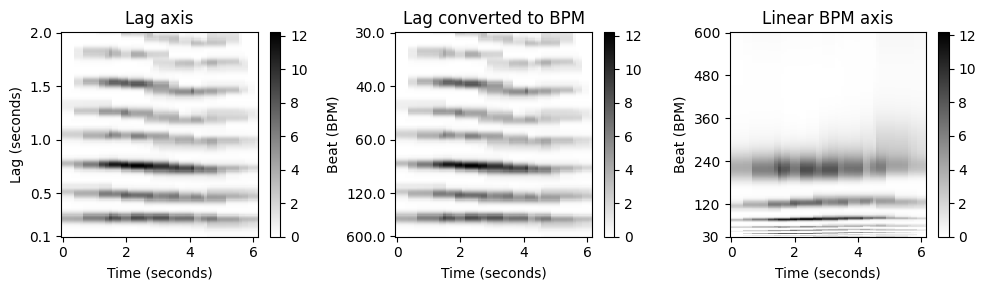

In [26]:
Theta = np.arange(30, 601)
tempogram, T_coef, F_coef, A, F_coef_lag = compute_tempogram_autocorr(nov, 
                            Fs_nov, N, H, norm_sum=False, Theta=Theta)

fig, ax = plt.subplots(1, 3, gridspec_kw={'width_ratios': [1, 1, 1]}, figsize=(10,3)) 

plot_matrix(A, T_coef=T_coef, F_coef=F_coef_lag, ax=[ax[0]],
                     title='Lag axis', ylabel='Lag (seconds)', colorbar=True);
lag_yticks = np.array([F_coef_lag[0], 0.5, 1.0, 1.5, F_coef_lag[-1]])
ax[0].set_yticks(lag_yticks)

plot_matrix(A, T_coef=T_coef, F_coef=F_coef_lag, ax=[ax[1]],
                     title='Lag converted to BPM', ylabel='Beat (BPM)', colorbar=True);
ax[1].set_yticks(lag_yticks)
ax[1].set_yticklabels(60/lag_yticks)

plot_matrix(tempogram, T_coef=T_coef, F_coef=F_coef, ax=[ax[2]],
                     title='Linear BPM axis', ylabel='Beat (BPM)', colorbar=True);
ax[2].set_yticks([F_coef[0], 120, 240, 360, 480, F_coef[-1]]);
plt.tight_layout()

## 템포 하모닉과 서브하모닉

- 다음에서는 템포 증가($20~\mathrm{sec}$에 걸쳐 $170$에서 $200~\mathrm{BPM}$로 상승)하는 클릭(click) 트랙을 고려하여 하모닉(=고조파) 및 서브하모닉을 설명한다. 이 예는 **자기상관 템포그램**이 템포 하모닉을 억제하면서 **템포 서브하모닉**을 나타내는 것을 보여준다.

- 이 이유는 노벨티 함수의 로컬 섹션과 $\ell$ 샘플 이동된 섹션과의 높은 상관관계가 정수 $k\in\mathbb{N}$에 대해 $k\cdot\ell$ lag만큼 이동된 섹션과의 높은 상관관계 또한 의미하기 때문이다.

- $\ell$이 tempo $\tau$에 해당한다고 가정하면, lag $k\cdot\ell$은 서브하모닉 $\tau/k$에 해당한다. 이는 **템포 하모닉스**를 강조하지만 템포 서브하모닉을 억제하는 **푸리에 템포그램**과 대조된다.

In [27]:
fn_wav = "FMP_C6_F11_ClickTrack-BPM170-200.wav"
Audio(path_data+ fn_wav)

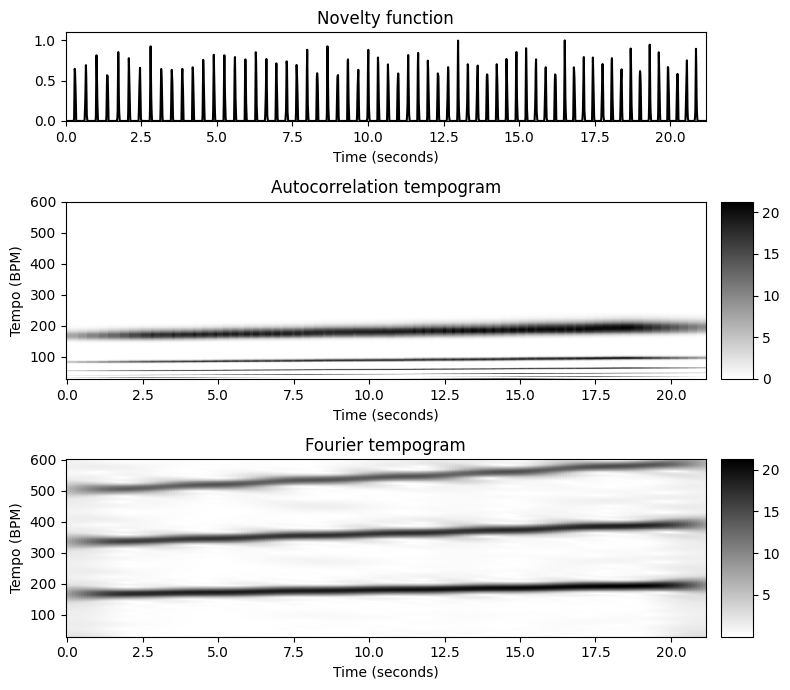

In [28]:
x, Fs = librosa.load(path_data+fn_wav) 

nov, Fs_nov = compute_novelty_spectrum(x, Fs=Fs, N=2048, H=512, gamma=100, M=10, norm=1)
nov, Fs_nov = resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)

#Autocorrelation parameters
N = 500 #corresponding to 5 seconds (Fs_nov = 100 Hz)
H = 10
Theta = np.arange(30, 601)
tempogram_A, T_coef, F_coef, A, F_coef_lag = compute_tempogram_autocorr(nov, Fs_nov, N, H, 
                                                 norm_sum=False, Theta=Theta)

fig, ax = plt.subplots(3, 2, gridspec_kw={'width_ratios': [1, 0.05], 
                                          'height_ratios': [1, 2, 2]}, figsize=(8,7))        
plot_signal(nov, Fs_nov, ax=ax[0,0], color='k', title='Novelty function')
ax[0,1].set_axis_off()
plot_matrix(tempogram_A, T_coef=T_coef, F_coef=F_coef, ax=[ax[1,0], ax[1,1]], 
                     title='Autocorrelation tempogram', ylabel='Tempo (BPM)', colorbar=True);


X, T_coef, F_coef_BPM = compute_tempogram_fourier(nov, Fs_nov, N=N, H=H, Theta=Theta)
tempogram_F = np.abs(X)

plot_matrix(tempogram_F, T_coef=T_coef, F_coef=F_coef_BPM, ax=[ax[2,0], ax[2,1]], 
                     title='Fourier tempogram', ylabel='Tempo (BPM)', colorbar=True)
plt.tight_layout()

# 순환 템포그램 (Cyclic Tempogram)

## 정의 

### 연속의 경우 (continuous)

- 피치의 맥락에서 고조파의 존재가 있는 것처럼 다양한 펄스 레벨이 있을 수 있다. 고조파의 영향을 줄이기 위해 크로마 기반 오디오 특징의 개념을 소개한 적 있다. 한 옥타브 또는 여러 옥타브 차이가 나는 피치를 식별하여 음색의 변화에 강건한 화성 정보를 캡처하는 순환(cyclic) 중간-레벨 표현을 얻었다. 크로마 특징의 개념에서 영감을 받아 이제 순환 템포그램(cyclic tempogram)의 개념을 소개한다.

- 기본 개념은 2의 제곱만큼 다른 템포를 식별하여 템포 등가 클래스를 형성하는 것이다. 더 정확하게는 $\tau_1$ 및 $\tau_2$ 두 템포가 어떤 $k\in \mathbb{Z}$에 대해 $\tau_1 = 2^{k} \tau_2$로 관련되어 있다면 이를 **옥타브 동등(equivalent)** 이라고 한다.

- 템포 매개변수 $\tau$의 경우, 결과 템포 등가 클래스를 $[\tau]$로 표시한다. 예를 들어 $\tau=120$의 경우 $[\tau]=\{\ldots,30,60,120,240,480\ldots\}$를 얻는다.  템포그램 표현 $\mathcal{T}:\mathbb{Z}\times \mathbb{R}_{>0} \to \mathbb{R}_{\geq 0}$가 주어지면 다음에 의해 **순환 템포그램**을 정의한다.
$$\mathcal{C}(n,[\tau]) := \sum_{\lambda\in[\tau]} \mathcal{T}(n,\lambda)$$

- 템포 등가 클래스는 위상적으로 원에 해당한다. 참조 템포 $\tau_0$을 고정하면, 순환 템포그램은 $\mathcal{C}_{\tau_0}:\mathbb{Z}\times \mathbb{R}_{>0} \to \mathbb{R}_{\geq 0}$ 매핑으로 나타나며 다음과 같이 정의된다.
$$\mathcal{C}_{\tau_0}(n,s):= \mathcal{C}(n,[s\cdot\tau_0])$$
for $n\in \mathbb{Z}$ and **scaling parameter**(**스케일링 매개변수**) $s\in\mathbb{R}_{>0}$

- 또한 다음을 참고할 수 있다.
$$\mathcal{C}_{\tau_0}(n,s)=\mathcal{C}_{\tau_0}(n,2^ks)$$
for $k\in\mathbb{Z}$

- 특히 $\mathcal{C}_{\tau_0}$는 $s\in[1,2)$ 값에 의해 완전히 결정된다.

### 이산의 경우 (discrete)

- 위는 템포 매개변수의 공간이 연속적이라고 가정했다. 하지만 실제로는 한정된 수의 매개변수 $s\in[1,2)$에 대해서만 순환 템포그램 $\mathcal{C}_{\tau_0}$를 계산할 수 있다.

- $\mathcal{C}_{\tau_0}(n,s)$ 값을 계산하려면 템포 매개변수 $\tau\in \{s\cdot\tau_0\cdot2^k\,\mid\,k\in\mathbb{Z}\}$에 대해 $\mathcal{T}(n,\tau)$ 값을 더해야 한다. 즉, 필요한 템포 값은 템포 축에서 기하급수적으로 배치된다. 따라서 로그 주파수 축을 사용하는 크로마 특징과 마찬가지로 순환 템포그램을 계산하기 위해서는 **로그-템포 축**이 필요하다.

- 이를 위해 각 템포 옥타브에 주어진 숫자 $M\in\mathbb{N}$에 대한 $M$ **템포 빈(bins)** 이 포함되도록 템포 범위를 로그 방식으로 샘플링한다. 그런 다음 이전과 같이 서로 다른 옥타브의 해당 값을 더함으로써 이산 순환 템포그램 $\mathcal{C}_{\tau_0}$를 얻는다. 이는 모든 시간 프레임 $n\in\mathbb{Z}$에 대해 $M$ 차원의 특징 벡터를 산출하며, 순환 템포 축은 $M$ 위치에서 샘플링된다.

## 순환 푸리에 템포그램

- 푸리에 템포그램으로 시작하자. 순환 버전은 $\mathcal{C}^\mathrm{F}_{\tau_0}$로 표시되는 **순환 푸리에 템포그램**이라고 한다. 다음에서는 템포가 증가하는 클릭 트랙($110$에서 $130~\mathrm{BPM}$)을 예로 사용한다.

In [29]:
fn_wav = "FMP_C6_Audio_ClickTrack-BPM110-130.wav"
Audio(path_data+fn_wav)

- 세 가지 단계로 나누어 볼 수 있다.
    * 먼저 $\Theta=[30:600]$에 해당하는 선형 템포 축으로 푸리에 템포그램을 계산한다.
    * 그런 다음 선형 템포 축을 로그 템포 축으로 변환한다. 이 단계에서는 참조 템포 $\tau_0=30~\mathrm{BPM}$를 사용하고 각각 $M=40$ 템포 빈을 포함하는 4개의 템포 옥타브를 커버한다.
    * 마지막으로 템포 옥타브를 식별하여 템포 축을 주기적으로 접는다(fold). 이는 $M$ 차원의 순환 템포그램을 생성한다.

In [30]:
def compute_cyclic_tempogram(tempogram, F_coef_BPM, tempo_ref=30,
                             octave_bin=40, octave_num=4):
    """Compute cyclic tempogram

    Args:
        tempogram (np.ndarray): Input tempogram
        F_coef_BPM (np.ndarray): Tempo axis (BPM)
        tempo_ref (float): Reference tempo (BPM) (Default value = 30)
        octave_bin (int): Number of bins per tempo octave (Default value = 40)
        octave_num (int): Number of tempo octaves to be considered (Default value = 4)

    Returns:
        tempogram_cyclic (np.ndarray): Cyclic tempogram tempogram_cyclic
        F_coef_scale (np.ndarray): Tempo axis with regard to scaling parameter
        tempogram_log (np.ndarray): Tempogram with logarithmic tempo axis
        F_coef_BPM_log (np.ndarray): Logarithmic tempo axis (BPM)
    """
    F_coef_BPM_log = tempo_ref * np.power(2, np.arange(0, octave_num*octave_bin)/octave_bin)
    F_coef_scale = np.power(2, np.arange(0, octave_bin)/octave_bin)
    tempogram_log = interp1d(F_coef_BPM, tempogram, kind='linear', axis=0, fill_value='extrapolate')(F_coef_BPM_log)
    K = len(F_coef_BPM_log)
    tempogram_cyclic = np.zeros((octave_bin, tempogram.shape[1]))
    for m in np.arange(octave_bin):
        tempogram_cyclic[m, :] = np.mean(tempogram_log[m:K:octave_bin, :], axis=0)
    return tempogram_cyclic, F_coef_scale, tempogram_log, F_coef_BPM_log


def set_yticks_tempogram_cyclic(ax, octave_bin, F_coef_scale, num_tick=5):
    """Set yticks with regard to scaling parmater

    Args:
        ax (mpl.axes.Axes): Figure axis
        octave_bin (int): Number of bins per tempo octave
        F_coef_scale (np.ndarra): Tempo axis with regard to scaling parameter
        num_tick (int): Number of yticks (Default value = 5)
    """
    yticks = np.arange(0, octave_bin, octave_bin // num_tick)
    ax.set_yticks(yticks)
    ax.set_yticklabels(F_coef_scale[yticks].astype((np.unicode_, 4)))

In [31]:
x, Fs = librosa.load(path_data+fn_wav) 

nov, Fs_nov = compute_novelty_spectrum(x, Fs=Fs, N=2048, H=512, 
                                                 gamma=100, M=10, norm=True)
nov, Fs_nov = resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)

In [32]:
X, T_coef, F_coef_BPM = compute_tempogram_fourier(nov, Fs_nov, 
                                                            N=500, H=10, 
                                                            Theta=np.arange(30, 601))
tempogram = np.abs(X)
tempo_ref = 30
octave_bin = 40
octave_num = 4
output = compute_cyclic_tempogram(tempogram, F_coef_BPM, 
              tempo_ref=tempo_ref, octave_bin=octave_bin, octave_num=octave_num)
tempogram_cyclic = output[0]
F_coef_scale = output[1]
tempogram_log = output[2]
F_coef_BPM_log = output[3]

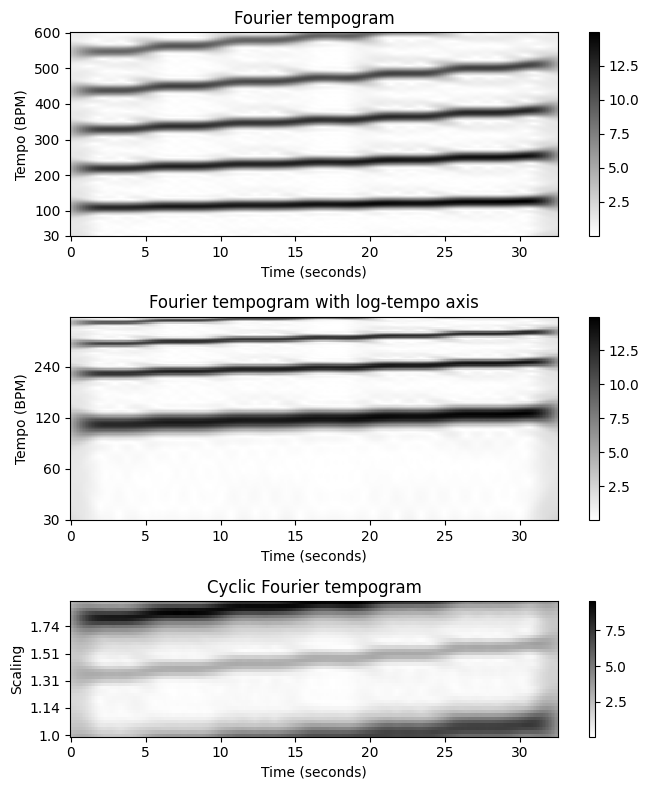

In [33]:
fig, ax = plt.subplots(3, 1, gridspec_kw={'height_ratios': [1.5, 1.5, 1]}, figsize=(7, 8))       

# Fourier tempogram
im_fig, im_ax, im = plot_matrix(tempogram, ax=[ax[0]],T_coef=T_coef, F_coef=F_coef_BPM,
                                         title='Fourier tempogram', 
                                         ylabel='Tempo (BPM)', colorbar=True);
ax[0].set_yticks([F_coef_BPM[0],100, 200, 300, 400, 500, F_coef_BPM[-1]]);

# Fourier tempogram with log tempo axis
im_fig, im_ax, im = plot_matrix(tempogram_log, ax=[ax[1]], T_coef=T_coef,
                                         title='Fourier tempogram with log-tempo axis', 
                                         ylabel='Tempo (BPM)', colorbar=True);
yticks = np.arange(octave_num) * octave_bin
ax[1].set_yticks(yticks)
ax[1].set_yticklabels(F_coef_BPM_log[yticks].astype(int));

# Cyclic Fourier tempogram
im_fig, im_ax, im = plot_matrix(tempogram_cyclic, ax=[ax[2]], T_coef=T_coef,
                                         title='Cyclic Fourier tempogram', 
                                         ylabel='Scaling', colorbar=True);
set_yticks_tempogram_cyclic(ax[2], octave_bin, F_coef_scale, num_tick=5)
plt.tight_layout()

## 순환 자기상관 템포그램

- 비슷하게 자기상관 템포그램으로 시작하여, 순환 버전으로 $\mathcal{C}^\mathrm{A}_{\tau_0}$로 표기되는 **순환 자기상관 템포그램(cyclic autocorrelation tempogram)** 을 얻는다.

- 참조 템포 $\tau_0=30~\mathrm{BPM}$ 및 클릭 트랙을 예로 사용하여 원래 자기 상관 템포그램, 로그 템포 축이 있는 템포그램 및 옥타브당 $M=40$ 템포 빈을 사용하는 순환 템포그램의 그림을 보자.

In [34]:
N = 500 
H = 10
Theta = np.arange(30, 601)
output = compute_tempogram_autocorr(nov, Fs_nov, N=N, H=H, 
                                              norm_sum=False, Theta=np.arange(30, 601))
tempogram = output[0]
T_coef = output[1]
F_coef_BPM = output[2]

tempo_ref = 30
octave_bin = 40
octave_num = 4
output = compute_cyclic_tempogram(tempogram, F_coef_BPM, tempo_ref=tempo_ref, 
                                  octave_bin=octave_bin, octave_num=octave_num)
tempogram_cyclic = output[0]
F_coef_scale = output[1]
tempogram_log = output[2]
F_coef_BPM_log = output[3]

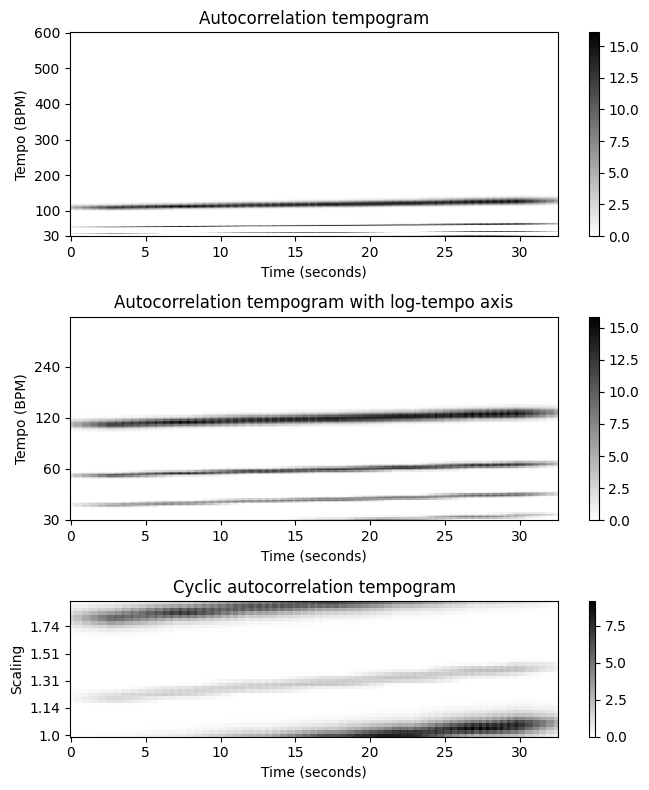

In [35]:
fig, ax = plt.subplots(3, 1, gridspec_kw={'height_ratios': [1.5, 1.5, 1]}, figsize=(7, 8))       

# Autocorrelation tempogram
im_fig, im_ax, im = plot_matrix(tempogram, ax=[ax[0]], T_coef=T_coef, 
                                         F_coef=F_coef_BPM, 
                                         figsize=(6,3), ylabel='Tempo (BPM)', colorbar=True,
                                         title='Autocorrelation tempogram');
ax[0].set_yticks([Theta[0],100, 200, 300, 400, 500, Theta[-1]]);

# Autocorrelation tempogram with log tempo axis
im_fig, im_ax, im = plot_matrix(tempogram_log, ax=[ax[1]], T_coef=T_coef, 
                                         figsize=(6,3), ylabel='Tempo (BPM)', colorbar=True,
                                         title='Autocorrelation tempogram with log-tempo axis');
yticks = np.arange(octave_num) * octave_bin
ax[1].set_yticks(yticks)
ax[1].set_yticklabels(F_coef_BPM_log[yticks].astype(int));

# Cyclic autocorrelation tempogram
im_fig, im_ax, im = plot_matrix(tempogram_cyclic, ax=[ax[2]], T_coef=T_coef, 
                                         figsize=(6,2), ylabel='Scaling', colorbar=True,
                                         title='Cyclic autocorrelation tempogram', );
set_yticks_tempogram_cyclic(ax[2], octave_bin, F_coef_scale, num_tick=5)
plt.tight_layout()

## 템포 하모닉과 서브하모닉

- 이전에 논의한 것처럼 푸리에 템포그램은 템포 하모닉(=고조파)를 강조하고 자기상관 템포그램은 템포 서브하모닉을 강조한다. 다음 그림에 설명된 대로 이러한 속성은 순환 버전의 템포그램에도 반영된다.

- 클릭 트랙의 **순환 푸리에 템포그램**에서 **템포 우세(dominant)** 는 시간 $t=0$에서 $s=1.33$로 시작하는 약하게 증가하는 선으로 표시된다. **순환 자기상관 템포그램**에서 **템포 우세**는 시간 $t=0$에서 $s=1.2$로 시작하는 약한 증가 선으로 나타난다.

- 또한 다음 그림은 작은 템포 해상도(resolution)($M=15$ 템포 빈)를 사용하는 버전뿐만 아니라 열 방향으로 정규화된 버전도 보여준다.

In [36]:
def plot_tempogram_Fourier_autocor(tempogram_F, tempogram_A, T_coef, F_coef_BPM, 
                                   octave_bin, title_F, title_A, norm=None):
    """Visualize Fourier-based and autocorrelation-based tempogram
    """
    fig, ax = plt.subplots(1, 2, gridspec_kw={'width_ratios': [1,1]}, figsize=(12, 1.5))       

    output = compute_cyclic_tempogram(tempogram_F, F_coef_BPM, octave_bin=octave_bin)
    tempogram_cyclic_F = output[0]
    F_coef_scale = output[1]
    if norm is not None:
        tempogram_cyclic_F = normalize_feature_sequence(tempogram_cyclic_F, 
                                                                  norm=norm)
    plot_matrix(tempogram_cyclic_F, T_coef=T_coef, ax=[ax[0]], 
                         title=title_F, ylabel='Scaling', colorbar=True);
    set_yticks_tempogram_cyclic(ax[0], octave_bin, F_coef_scale, num_tick=5)

    output = compute_cyclic_tempogram(tempogram_A, F_coef_BPM, octave_bin=octave_bin)
    tempogram_cyclic_A  = output[0]
    F_coef_scale = output[1]
    if norm is not None:
        tempogram_cyclic_A = normalize_feature_sequence(tempogram_cyclic_A, 
                                                                  norm=norm)    
    plot_matrix(tempogram_cyclic_A, T_coef=T_coef, ax=[ax[1]], 
                         title=title_A, ylabel='Scaling', colorbar=True);
    set_yticks_tempogram_cyclic(ax[1], octave_bin, F_coef_scale, num_tick=5)

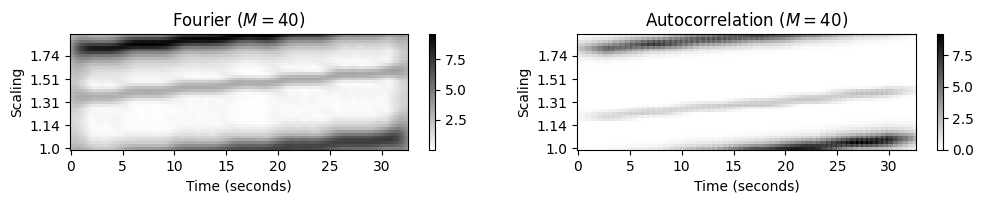

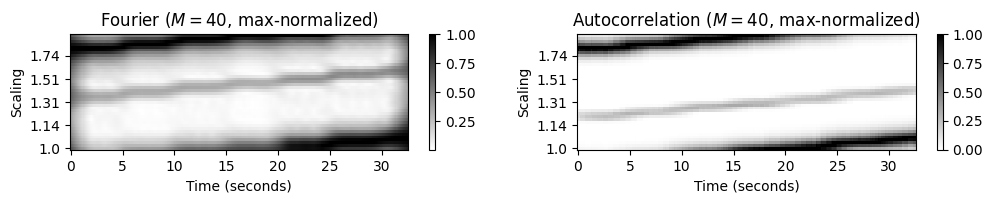

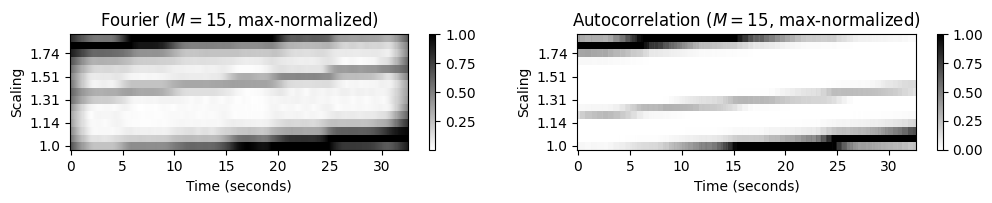

In [37]:
N = 500 
H = 10
Theta = np.arange(30, 601)
X, T_coef, F_coef_BPM = compute_tempogram_fourier(nov, Fs_nov, N=N, H=H, 
                                                            Theta=Theta)
tempogram_F = np.abs(X)
output = compute_tempogram_autocorr(nov, Fs_nov, N=N, H=H, 
                                    Theta=Theta, norm_sum=False)
tempogram_A = output[0]

octave_bin=40
title_F = r'Fourier ($M=%d$)'%octave_bin
title_A = r'Autocorrelation ($M=%d$)'%octave_bin
plot_tempogram_Fourier_autocor(tempogram_F, tempogram_A, T_coef, F_coef_BPM, 
                               octave_bin, title_F, title_A)

octave_bin=40
title_F = r'Fourier ($M=%d$, max-normalized)'%octave_bin
title_A = r'Autocorrelation ($M=%d$, max-normalized)'%octave_bin
plot_tempogram_Fourier_autocor(tempogram_F, tempogram_A, T_coef, F_coef_BPM, 
                               octave_bin, title_F, title_A, norm='max')

octave_bin=15
title_F = r'Fourier ($M=%d$, max-normalized)'%octave_bin
title_A = r'Autocorrelation ($M=%d$, max-normalized)'%octave_bin
plot_tempogram_Fourier_autocor(tempogram_F, tempogram_A, T_coef, F_coef_BPM, 
                               octave_bin, title_F, title_A, norm='max')

## 템포 피쳐 (Tempo features)

- 순환 템포그램 표현은 하모니 기반(harmony-based) 크로마그램 표현의 템포 기반(tempo-based) 대응이다.

- 표준 템포그램과 비교하여 순환 버전은 다양한 펄스 레벨로 인해 발생하는 모호성에 더 강하다. 또한 순환 템포그램을 주기적으로 이동하여 템포의 변화를 시뮬레이션할 수 있다. 이는 피치 변조를 시뮬레이션하기 위해 주기적으로 이동할 수 있는 크로마그램의 속성과 유사하다. 

- 한 가지 추가 이점으로, 이산 순환 템포그램의 저차원 버전도 여전히 기본 음악 신호의 중요한 로컬 템포 정보를 담고 있다는 것이다.

- 템포 기반 오디오 특징의 잠재력을 설명하기 위해 음악 구조 분석 작업을 고려해 보자.

- 노벨티(novelty) 기반, 반복(repetition) 기반 및 동질성(homogeneity) 기반 접근 방식을 포함하여 음악 신호를 세분화하기 위한 다양한 전략을 고려했다. 동질성 기반은 음악 신호를 특정 음악 속성과 관련하여 동질적인 세그먼트로 분할하는 것이다. 이러한 맥락에서 음색, 하모니, 템포와 같은 다양한 음악적 속성을 포착하는 다양한 특징 표현을 고려했다. 

- 이제 순환 템포그램이 템포 기반 분할에 어떻게 유용한지 알아보자.

### 예시: Brahms

- Brahms의 헝가리 무곡을 예로 보자. 음악적 구조는 $A_1A_2B_1B_2CA_3B_3B_4D$아며, 서로 다른 파트는 서로 다른 템포로 연주된다. 또한 일부 파트 내에서도 급격한 템포 변화가 많이 있다.

- 다음 그림에서는 순환 자기상관과 푸리에 템포그램 표현을 보여준다. 이러한 표현은 정확한 템포를 나타내지는 않지만 **동질성 기반 구조 분석**에 유용할 수 있는 템포 관련 정보를 캡처한다.

- Brahms 예에서 순환 템포그램은 낮은 차원의 템포 표현을 기반으로 음악적으로 의미 있는 세그먼트를 생성한다. 이러한 세그먼트는 MFCC 또는 크로마 특징을 사용하여 복구할 수 없다. 동질성 가정은 음색이나 하모니와 관련해서는 유지되지 않기 때문이다.

In [52]:
# Annotation
fn_ann = 'FMP_C4_Audio_Brahms_HungarianDances-05_Ormandy.csv'
ann, color_ann = read_structure_annotation(path_data+fn_ann,
                                                     Fs=1, remove_digits=False)

# Audio file 
fn_wav = 'FMP_C4_Audio_Brahms_HungarianDances-05_Ormandy.wav'

x, Fs = librosa.load(path_data+fn_wav)

nov, Fs_nov = compute_novelty_spectrum(x, Fs=Fs, N=2048, H=512, 
                                                 gamma=100, M=10, norm=True)
nov, Fs_nov = resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)

octave_bin = 15
X, T_coef, F_coef_BPM = compute_tempogram_fourier(nov, Fs_nov, N=500, H=50, 
                                                            Theta=np.arange(30, 601))
tempogram_F = np.abs(X)

tempogram_A, T_coef, F_coef_BPM, _, _ = compute_tempogram_autocorr(nov, Fs_nov,
                                                                             N=500, H=50,
                                                                             norm_sum=False,
                                                                             Theta=np.arange(30, 601))

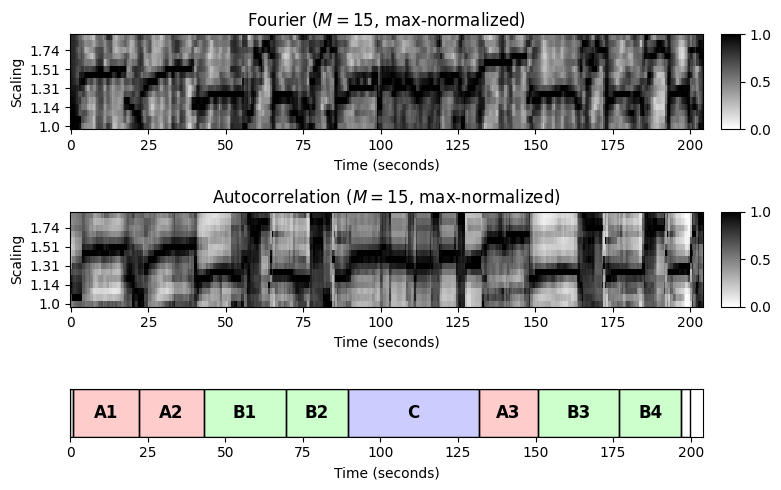

In [53]:
fig, ax = plt.subplots(3, 2, gridspec_kw={'width_ratios': [1, 0.03], 
                                          'height_ratios': [2, 2, 1]}, figsize=(8, 5))       

output = compute_cyclic_tempogram(tempogram_F, F_coef_BPM, octave_bin=octave_bin)
tempogram_cyclic_F = output[0]
F_coef_scale = output[1]

tempogram_cyclic_F = normalize_feature_sequence(tempogram_cyclic_F, norm='max')
plot_matrix(tempogram_cyclic_F, T_coef=T_coef, ax=[ax[0,0], ax[0,1]], clim=[0,1],
                     title='Fourier ($M=15$, max-normalized)', 
                     ylabel='Scaling', colorbar=True);
set_yticks_tempogram_cyclic(ax[0,0], octave_bin, F_coef_scale, num_tick=5)

output = compute_cyclic_tempogram(tempogram_A, F_coef_BPM, octave_bin=octave_bin)
tempogram_cyclic_A = output[0]
F_coef_scale = output[1]

tempogram_cyclic_A = normalize_feature_sequence(tempogram_cyclic_A, norm='max')
plot_matrix(tempogram_cyclic_A, T_coef=T_coef, ax=[ax[1,0], ax[1,1]], clim=[0,1],
                     title='Autocorrelation ($M=15$, max-normalized)', 
                     ylabel='Scaling', colorbar=True);
set_yticks_tempogram_cyclic(ax[1,0], octave_bin, F_coef_scale, num_tick=5)

plot_segments(ann, ax=ax[2,0], time_max=(x.shape[0])/Fs, 
                       colors=color_ann, time_label='Time (seconds)')
ax[2,1].axis('off')

plt.tight_layout()

### 예시: Zager and Evans


- 다음의 예는 "In the Year 2525"  - Zager and Evans이다. 이 노래는 $IV_1V_2V_3V_4V_5V_6V_7BV_8O$ 구조이며, 다소 모호한 템포와 리듬의 느린 인트로로 시작한다 ($I$-part). 음악은 주로 기타의 끊임없는 스트러밍과 함께 목소리가 지배적이다. 곡 후반부 브릿지($B$-파트)도 같은 스타일로 연주된다. 인트로와 브릿지와 달리 8개의 반복되는 벌스 섹션($V$-파트)은 타악기의 명확한 템포와 리듬으로 훨씬 빠르게 연주된다. 

- 다음 그림에서 볼 수 있듯이 느린 부분은 두 순환 템포그램 $\mathcal{C}^\mathrm{F}_{60}$ 및 $\mathcal{C}^\mathrm{ A}_{60}$에서 빠른 부분과 명확히 구분된다.
    - 느린 부분에서 템포그램은 명확한 템포가 보이지 않는 잡음과 같은 특성을 나타낸다. 
    - 대조적으로 빠른 부분에서 템포그램은 벌스 부분의 실제 상수 템포 $\tau=s\cdot 60\cdot 2=126~\mathrm{BPM}$을 반영하는 스케일링 매개변수 값 $s=1.05$에 해당하는 지배적인 템포를 가진다.

In [54]:
# Annotation
fn_ann = 'FMP_C4_F13_ZagerEvans_InTheYear2525.csv'
ann, color_ann = read_structure_annotation(path_data+fn_ann, fn_ann_color='InTheYear2525', 
                                                     Fs=1, remove_digits=False)

# Audio file 
fn_wav = 'FMP_C4_F13_ZagerEvans_InTheYear2525.wav'
x, Fs = librosa.load(path_data+fn_wav)

nov, Fs_nov = compute_novelty_spectrum(x, Fs=Fs, N=2048, H=512, 
                                                 gamma=100, M=10, norm=True)
nov, Fs_nov = resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)

octave_bin = 15
X, T_coef, F_coef_BPM = compute_tempogram_fourier(nov, Fs_nov, N=500, H=50, 
                                                            Theta=np.arange(30, 601))
tempogram_F = np.abs(X)

tempogram_A, T_coef, F_coef_BPM, _, _ = compute_tempogram_autocorr(nov, Fs_nov,
                                                                             N=500, H=50,
                                                                             norm_sum=False,
                                                                             Theta=np.arange(30, 601))

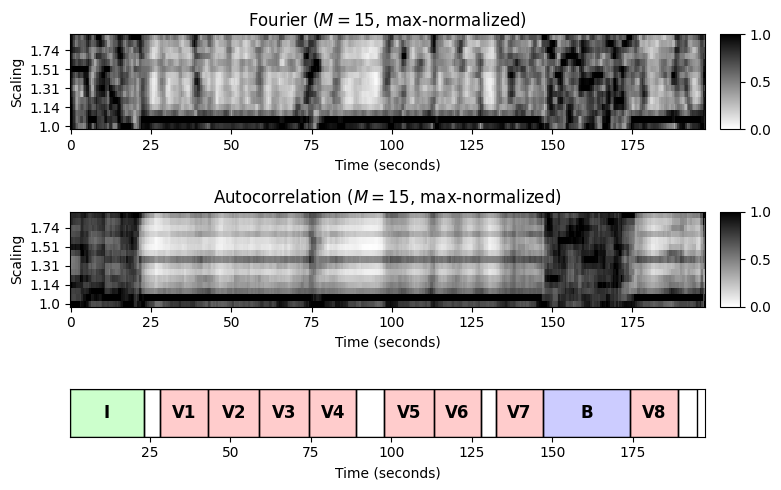

In [55]:
fig, ax = plt.subplots(3, 2, gridspec_kw={'width_ratios': [1, 0.03], 
                                          'height_ratios': [2, 2, 1]}, figsize=(8, 5))

output = compute_cyclic_tempogram(tempogram_F, F_coef_BPM, octave_bin=octave_bin)
tempogram_cyclic_F = output[0]
F_coef_scale = output[1]

tempogram_cyclic_F = normalize_feature_sequence(tempogram_cyclic_F, norm='max')
plot_matrix(tempogram_cyclic_F, T_coef=T_coef, ax=[ax[0,0], ax[0,1]], clim=[0,1],
                     title='Fourier ($M=%d$, max-normalized)'%octave_bin, 
                     ylabel='Scaling', colorbar=True);
set_yticks_tempogram_cyclic(ax[0,0], octave_bin, F_coef_scale, num_tick=5)

output = compute_cyclic_tempogram(tempogram_A, F_coef_BPM, octave_bin=octave_bin)
tempogram_cyclic_A = output[0]
F_coef_scale = output[1]

tempogram_cyclic_A = normalize_feature_sequence(tempogram_cyclic_A, norm='max')
plot_matrix(tempogram_cyclic_A, T_coef=T_coef, ax=[ax[1,0], ax[1,1]], clim=[0,1],
                     title='Autocorrelation ($M=%d$, max-normalized)'%octave_bin, 
                     ylabel='Scaling', colorbar=True);
set_yticks_tempogram_cyclic(ax[1,0], octave_bin, F_coef_scale, num_tick=5)

plot_segments(ann, ax=ax[2,0], time_max=(x.shape[0])/Fs, 
                       colors=color_ann, time_label='Time (seconds)')
ax[2,1].axis('off')

plt.tight_layout()

# Librosa 함수 예제

In [42]:
x, sr = librosa.load('../audio/58bpm.wav')
ipd.Audio(x, rate=sr)

## Fourier Tempogram

In [43]:
hop_length = 200 # samples per frame
onset_env = librosa.onset.onset_strength(y=x, sr=sr, hop_length=hop_length, n_fft=2048)

In [44]:
frames = range(len(onset_env))
t = librosa.frames_to_time(frames, sr=sr, hop_length=hop_length)

Text(0.5, 1.0, 'Novelty Function')

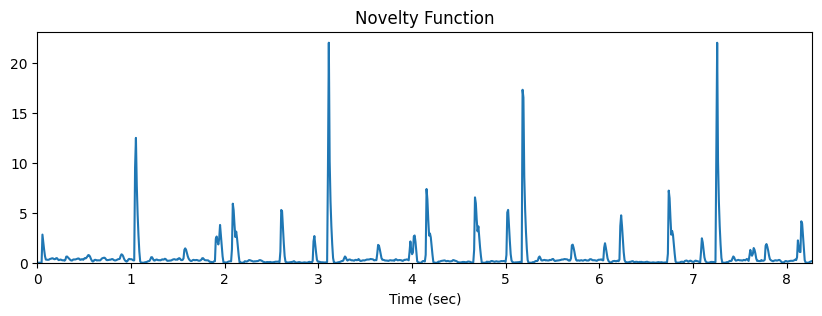

In [45]:
plt.figure(figsize=(10,3))
plt.plot(t, onset_env)
plt.xlim(0, t.max())
plt.ylim(0)
plt.xlabel('Time (sec)')
plt.title('Novelty Function')

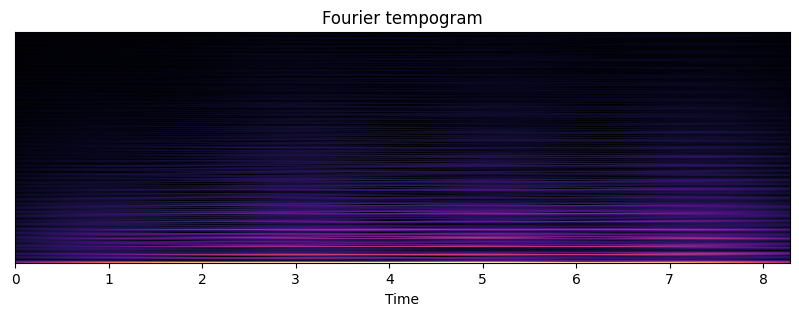

In [46]:
# Fourier Tempogram
S = librosa.stft(onset_env, hop_length=1, n_fft=512)
fourier_tempogram = np.absolute(S)

plt.figure(figsize=(10,3))
plt.title('Fourier tempogram')
librosa.display.specshow(fourier_tempogram, sr=sr, hop_length=hop_length, x_axis='time')
plt.show()

## Autocorrelation Tempogram

In [47]:
tmp = np.log1p(onset_env)
r = librosa.autocorrelate(tmp)

(0.0, 324.6555850873676)

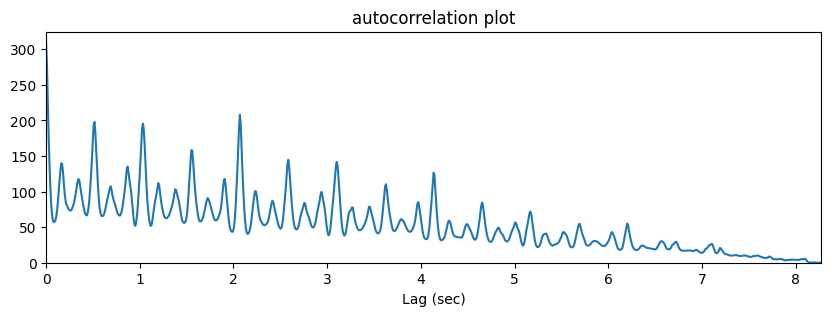

In [48]:
plt.figure(figsize=(10,3))
plt.title("autocorrelation plot")
plt.plot(t, r)
plt.xlim(0, t.max())
plt.xlabel('Lag (sec)')
plt.ylim(0)

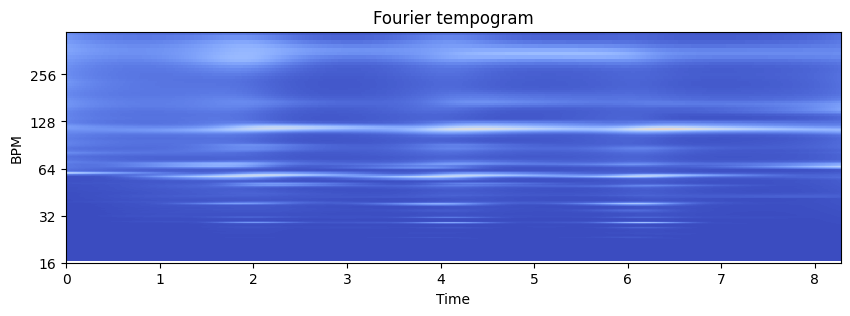

In [49]:
tempogram = librosa.feature.tempogram(onset_envelope=onset_env, sr=sr, hop_length=hop_length, win_length=400)

plt.figure(figsize=(10,3))
plt.title('Fourier tempogram')
librosa.display.specshow(tempogram, sr=sr, hop_length=hop_length, x_axis='time', y_axis='tempo')
plt.show()

## Estimating Global Tempo

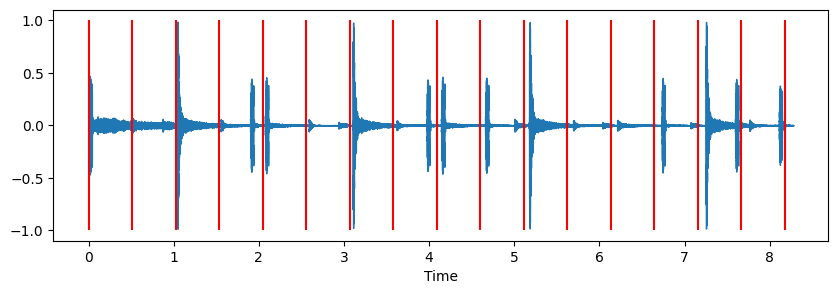

In [50]:
tempo = librosa.beat.tempo(y=x, sr=sr)
T = len(x)/float(sr)
seconds_per_beat = 60.0/tempo[0]
beat_times = np.arange(0, T, seconds_per_beat)

plt.figure(figsize=(10,3))
librosa.display.waveshow(y=x)
plt.vlines(beat_times, -1, 1, color='r')

In [51]:
clicks = librosa.clicks(times=beat_times, sr=sr, length=len(x))
ipd.Audio(x + clicks, rate=sr)

---

출처: 

- https://www.audiolabs-erlangen.de/resources/MIR/FMP/C6/C6S1_PeakPicking.html
- https://www.audiolabs-erlangen.de/resources/MIR/FMP/C6/C6S2_TempoBeat.html
- https://www.audiolabs-erlangen.de/resources/MIR/FMP/C6/C6S2_TempogramFourier.html
- https://www.audiolabs-erlangen.de/resources/MIR/FMP/C6/C6S2_TempogramAutocorrelation.html
- https://www.audiolabs-erlangen.de/resources/MIR/FMP/C6/C6S2_TempogramCyclic.html
- https://colab.research.google.com/github/stevetjoa/musicinformationretrieval.com/blob/gh-pages/tempo_estimation.ipynb

---

[구글 Colab 링크](https://colab.research.google.com/github/jo-cho/mir_kr/blob/main/Notebooks/7.%20Tempo%20and%20Beat%20Tracking/7.2.Tempo_Analysis.ipynb)